In [2]:
%%time

import sys
if sys.version_info.major == 3 and sys.version_info.minor >= 10:
    import collections
    setattr(collections, "MutableMapping", collections.abc.MutableMapping)
    
import FlowCytometryTools
import numpy as np
import scipy as scipy
from scipy.stats import gaussian_kde
import pandas as pd
from numpy import median
from numpy import mean
from numpy import std
import seaborn as sns
%matplotlib inline
import matplotlib as mpl

import matplotlib.pyplot as plt
import os

import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.lines import Line2D
from matplotlib.collections import CircleCollection
from pathlib import Path
import subprocess
import os, sys, stat
import json
from matplotlib.pyplot import figure
import matplotlib.colors as colors
import matplotlib.cm as cmx
from tkinter import Tk
from tkinter import filedialog
import collections
from collections import defaultdict
import pickle
from sklearn.neighbors import KernelDensity
import random
import sklearn as scikit
import numpy as np
from scipy import linalg
import itertools
from sklearn import mixture
import mpl_scatter_density # adds projection='scatter_density'
from matplotlib.colors import LinearSegmentedColormap
import itertools
import gc
import time
from IPython.display import clear_output

CPU times: total: 594 ms
Wall time: 2.35 s


In [3]:
path = r"E:\transfer\data\Sorter\Processed cocat for tagged protease\\"
# outpath = r'E:\transfer\data\Sorter\CA_MONOCLONAL_VC_SORTS_2282024\CA_MONOCLONAL_VC_SORTS_2282024 - (2)\results\\'

In [4]:
files = {}
folders = os.listdir(path)
for folder in folders:
    print(folder)
    filepath = os.path.join( path,folder)
    print(filepath)
    filenames = os.listdir(filepath)
    temp={}
    for file in filenames:
        print(file)
        temp[file] = pd.read_csv(os.path.join(filepath,file))
    files[folder] = temp
    print("+====================================+++++")

120h
E:\transfer\data\Sorter\Processed cocat for tagged protease\\120h
vc1_fl2++D53_sort - 1_[2 Way] Data Source - 1.csv
vc1_fl2++D54_sort_[2 Way] Data Source - 1.csv
vc1_fl2++D55_sort - 1_[2 Way] Data Source - 1.csv
vc1_fl2-3++D49_Data Source - 1.csv
vc1_fl2-3++D53_sort_[2 Way] Data Source - 1.csv
vc1_fl2-3++D54_sort  - 1_[2 Way] Data Source - 1.csv
vc1_fl2-3++D55_sort_[2 Way] Data Source - 1.csv
vc1_fl2-3++D56_sort_[2 Way] Data Source - 1.csv
vc4_fl2++D53_sort  - 1_[2 Way] Data Source - 1.csv
vc4_fl2++D54_sort  - 2_[2 Way] Data Source - 1.csv
vc4_fl2++D55_sort  - 3_[2 Way] Data Source - 1.csv
vc4_fl2-3++D49_Data Source - 1.csv
vc4_fl2-3++D53_sort  - 1_[2 Way] Data Source - 1.csv
vc4_fl2-3++D54_sort_[2 Way] Data Source - 1.csv
vc4_fl2-3++D56_PREsort_Data Source - 1.csv
+====================================+++++
48h
E:\transfer\data\Sorter\Processed cocat for tagged protease\\48h
10_Data Source - 1.csv
11_Data Source - 1.csv
12_Data Source - 1.csv
13_Data Source - 1.csv
14_Data Source 

In [6]:
tps = [x for x in files.keys()]
fs = [x for x in files[tps[0]].keys()]
ffs = [x for x in files[tps[2]].keys()]
tts = [x for x in files[tps[1]].keys()]
stables = [x for x in files[tps[3]].keys()]

In [20]:
ss = stables[1]

In [8]:
pinks = ['#2b001c','#630f46','#a6006c','#c2027f','#e80c9b','#fa32b4','#ff85d4','#fac3e7']
reds = ['#570303','#8a1616','#bd0404','#a82c2c','#f00202','#ff3d3d','#fa7575','#ffb5b5']
oranges = ['#3d2201','#7a4d15','#b36404','#ff8c00','#eb9834','#f0ab56','#ffc680','#ffd39e']
yellows = ['#4d4809','#7a7305','#9c931a','#c4b914','#f2e307','#f7ea2a','#ebe052','#faf393']
greens = ['#043801','#13590e','#1e8a15','#13ba04','#30f005','#63cf4a','#b9fa93','#99ed68']
cyans = ['#002625','#0e4d4a','#046e6a','#0d8c7d','#07b5af','#07e0d9','#14ecf7','#44f3fc']
blues = ['#011633','#0b1347','#063269','#064591','#1c57bd','#0505f0','#466dfa','#6b8afa','#97acf7','#d1dbff']
purples = ['#190129','#2f0a47','#400269','#66169c','#8102d6','#a831f7','#9d5cff','#bf98fa']
master_colors = [pinks, reds, oranges,yellows,greens,cyans,blues,purples]
ding = 2

colrs = itertools.cycle([master_colors[ii][ding] for ii in range(len(master_colors))])
fps = ['FL1-A', 'FL2-A','FL3-A','FL4-A','FL5-A', 'FL6-A']

In [16]:
%%time
fu =True
alp = 0.5
p1 = 0.4
p2 =0.2
siz = 0.1
# fig, axes = plt.subplots(1,2, figsize = (8,4), dpi = 200)
# axes = axes.flatten()
chan1 = 'FSC-A'
chan2 = 'FSC-H'
chan3 = 'SSC-A'
jj =0
shift =0
col = reds[3]
# axes[0].scatter(files[jj][chan1],files[jj][chan3],c = col,alpha = 0.1,s = 0.1)
# axes[1].scatter(files[jj][chan1],files[jj][chan2],c = col,alpha = 0.1,s = 0.1)
# fig.tight_layout()
# colors = ['k',"#ffc821", "cornflowerblue", "#a6ff21","#b8325a","#560094","#006a94"]
chans = ['FL1-A', 'FL2-A', 'FL3-A', 'FL4-A','FL5-A','FL6-A']
chania = [('FL1-A', 'FL2-A'), ('FL1-A', 'FL3-A'), ('FL2-A', 'FL3-A'),('FL2-A', 'FL6-A'),('FL6-A', 'FL3-A'),('FL1-A', 'FL6-A')]
lims = [(-500,10000),(-500,50000),(-500,30000),(-100,10000),(-100,1000),(-100,1000)]

for cells,col,tits in zip(files,colors,filenames):
    print(tits)
    fig, axes = plt.subplots(2,2, figsize = (8,8), dpi = 200)
    axes = axes.flatten()
    axes[0].scatter(cells[chan1],cells[chan3],c = col,alpha = 0.1,s = 0.1)
    axes[1].scatter(cells[chan1],cells[chan2],c = col,alpha = 0.1,s = 0.1)
    sns.histplot(cells[chan1],ax = axes[2],color = col,log_scale =True, fill = fu, alpha = alp,bins =10000)
    sns.histplot(cells[chan3],ax = axes[3],color = col,log_scale =True, fill = fu, alpha = alp,bins =10000)
    fig.suptitle(tits)
    fig.tight_layout()
    print(cells[chan1].count())
    fig.savefig(str(outpath) + f'{"SZ_"+tits[:-20]}.png')
    plt.show(block=False)
    plt.close()
    gc.collect()
    fig1, axes1 = plt.subplots(3,6, figsize = (16,8), dpi = 400)
    axes1 = axes1.flatten()
    for chan,lim,i in zip(chans,lims,range(len(chans))):
        sns.histplot(cells.loc[cells[chan]>0][chan],ax = axes1[i],color = col,log_scale =True, fill = fu, alpha = alp,bins =10000)
        # axes1[i].set_xlim(500,lim[1])
        axes1[i].set_xscale('log')
        axes1[i].set_xlabel(chan)

    for chan,lim,ax in zip(chans,lims,axes1[len(chans):2*(len(chans))]):
        ax.scatter(cells[chan]+shift,cells[chan1],c = col,alpha = 0.1,s = 0.1)
        # ax.set_xlim(lim[0],lim[1])
        ax.set_xlabel(chan)
        # ax.set_ylim(100000,3000000)
        ax.set_yscale('log')
        ax.set_ylabel(chan1)
        ax.set_yticks([100000,200000,300000,400000,500000,600000], [1,2,3,4,5,6])
        
    for chan,ax in zip(chania,axes1[2*len(chans):3*(len(chans))]):
        ax.scatter(cells[chan[0]]+shift,cells[chan[1]]+shift,c = col,alpha = 0.1,s = 0.1)
        ax.set_xlim(1,10000000)
        ax.set_xscale('log')
        ax.set_xlabel(chan[0])
        ax.set_ylim(1,10000000)
        ax.set_yscale('log')
        ax.set_ylabel(chan[1])
    fig1.suptitle(tits)
    fig1.tight_layout()




    fig1.savefig(str(outpath)+ f'{"FL_"+tits[:-20]}.png')
    plt.show(block=False)
    plt.close()
    gc.collect()
    
    clear_output()


CPU times: total: 42min 36s
Wall time: 46min 22s


In [18]:
import matplotlib as mpl 
cmapx = mpl.colors.LinearSegmentedColormap.from_list('my_cmap', ["white",'#5eced6','#036bfc','#4e03fc',"#c603fc","#fc035a","#b80e02" ], 300)

D:\Anaconda\Lib\site-packages\mpl_scatter_density\generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
D:\Anaconda\Lib\site-packages\mpl_scatter_density\generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)
C:\Users\cheta\AppData\Roaming\Python\Python311\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try kdeplot.
  warnings.warn(msg, UserWarning)
C:\Users\cheta\AppData\Roaming\Python\Python311\site-packages\seaborn\distributions.py:1176: UserWarning: The following kwargs were not used by contour: 'shade'
  cset = contour_func(


Error in callback <function _draw_all_if_interactive at 0x00000259FBE27060> (for post_execute):


ValueError: math domain error

ValueError: math domain error

<Figure size 2400x1000 with 3 Axes>

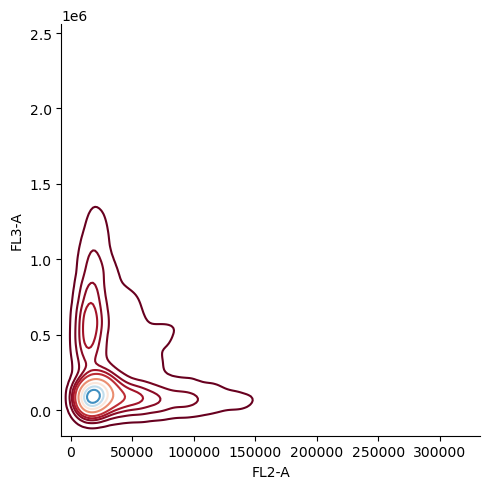

In [21]:
white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
        (0, '#ffffff'),
        (1e-20, '#b5f3f7'),
        (0.1, '#036bfc'),
        (0.2, '#4e03fc'),
        (0.5, '#ae38d9'),
        (0.6, '#d64fc4'),
        (0.8, '#eb3838'),
        (1, '#a10303')
    ], N=256)

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
        (0, '#ffffff'),
        (1e-20, '#440053'),
        (0.1, '#000080'),
        (0.2, '#0080ff'),
        (0.5, '#7bff7b'),
        (0.6, '#ff9700'),
        (0.8, '#800000'),
        (1, '#800000')
    ], N=256)
fig,ax = plt.subplots(1,2,figsize =(12,5),dpi = 200)
ax = ax.flatten()
ax1 = ax[0]
tps = [x for x in files.keys()]
tp = 1
kk = 7
ax1.tick_params(left = False, right = False , labelleft = False ,
                labelbottom = False, bottom = False)
ax1 = fig.add_subplot(1, 2, 1, projection='scatter_density')
ax1.scatter_density(files[tps[tp]][kk][fps[1]],files[tps[tp]][kk][fps[2]], cmap=white_viridis)
ax1.set_yscale("log")
ax1.set_xscale("log")
ax1.set_xlim(500,20000)
ax[1].set_yscale("log")
ax[1].set_xscale("log")
# ax[1].set_xlim(500,20000)
sns.displot(data=files[tps[tp]][kk], x=fps[1], y=fps[2], ax=ax[1],kind = "kde", shade = True, cmap = "RdBu")
ax[1].patch.set_facecolor('white')

NameError: name 'ss' is not defined

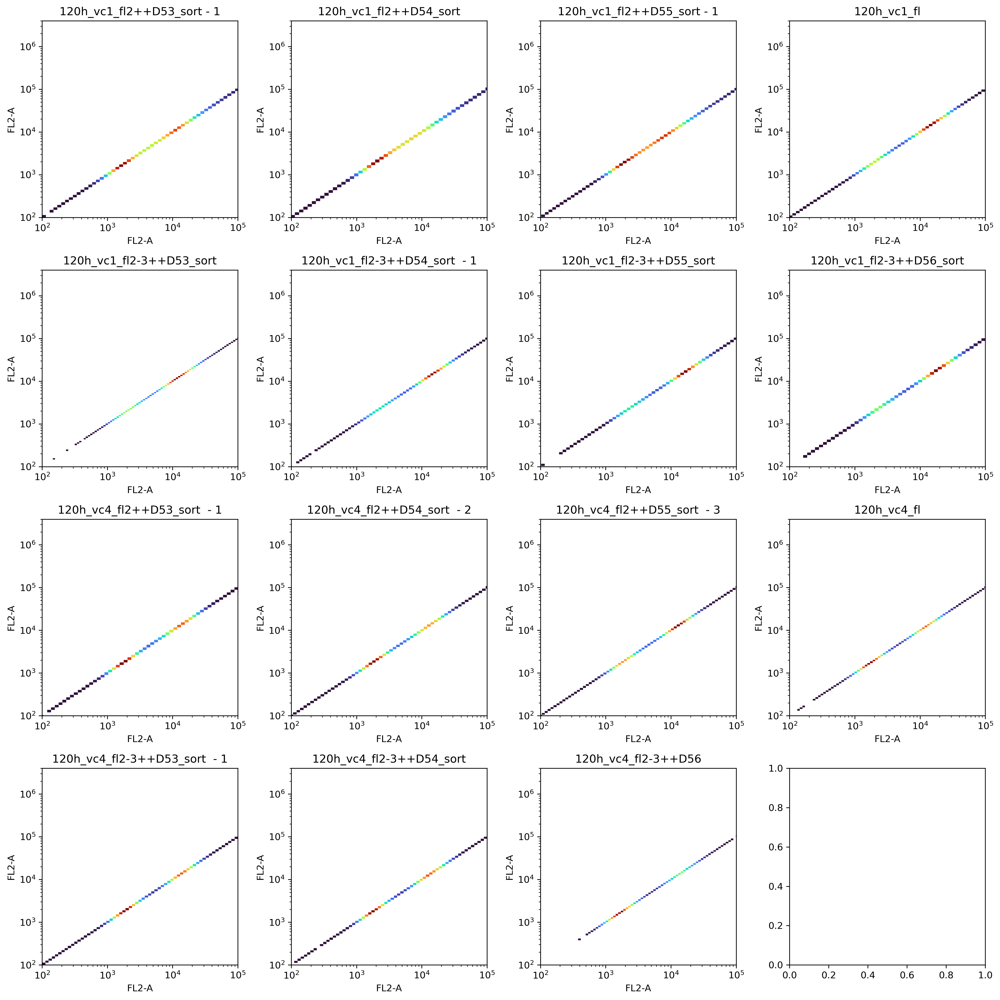

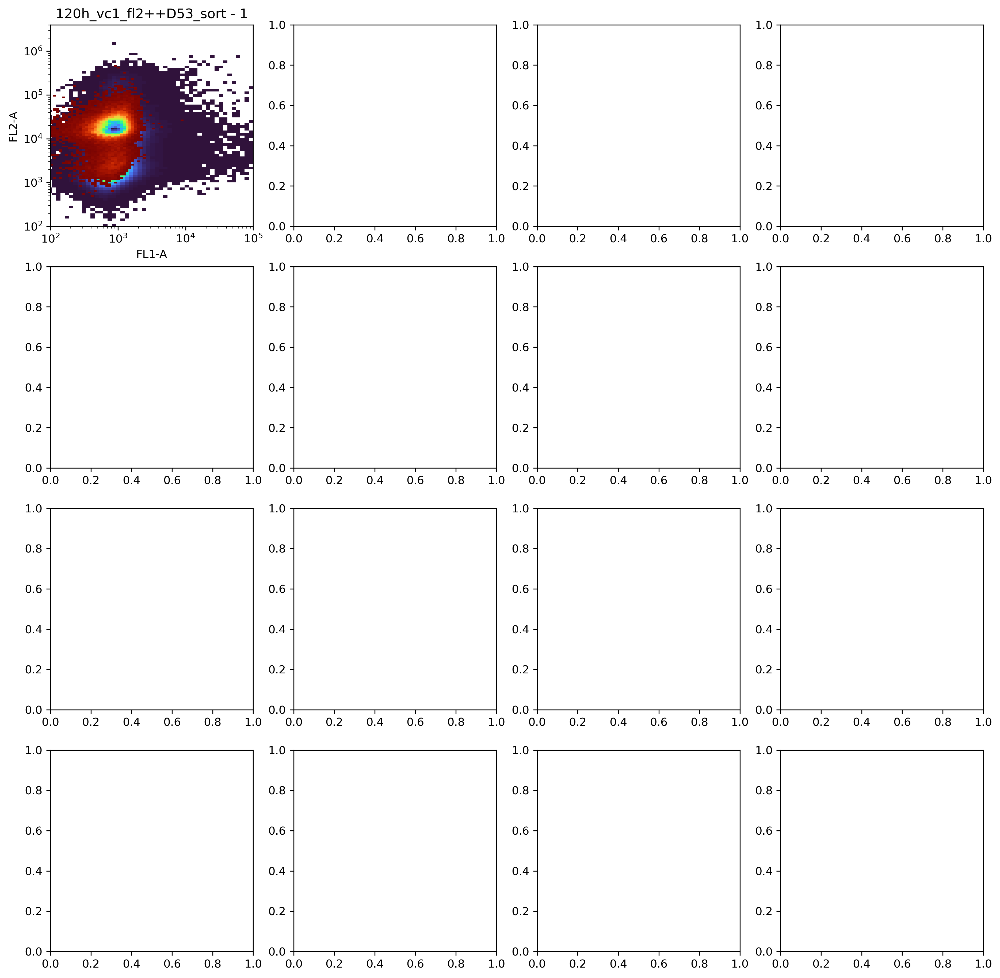

In [9]:
#VC1 fl2+ fl3+
tp = 0
b=100
thresh = 0
fs = [x for x in files[tps[tp]].keys()]
fig,ax = plt.subplots(4,4,figsize =(15,15),dpi = 300)
ax = ax.flatten()
ffs = [x for x in files[tps[2]].keys()]
ctrl = ffs[0]
for jj,f in enumerate(fs):
    threshed_data = files[tps[tp]][f].loc[files[tps[tp]][f][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[1], y=fps[1],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )
    # sns.histplot(
    #    data=files[kk], x=fps[1], y=fps[2],
    #     bins=b, discrete=(False, False), log_scale=(True, True),
    #     cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    # )
    ax[jj].set_title(str(tps[tp] + "_" + f[0:-28]) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

fig,ax = plt.subplots(4,4,figsize =(15,15),dpi = 300)
ax = ax.flatten()
for jj,f in enumerate(fs):
    threshed_data = files[tps[tp]][f].loc[files[tps[tp]][f][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[0], y=fps[1],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )    
    threshed_data = files[tps[2]][ctrl].loc[files[tps[2]][ctrl][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[0], y=fps[1],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo_r", ax = ax[jj]
    )
    ax[jj].set_title(str(tps[tp] + "_" + f[0:-28]) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)

    threshed_data = files[tps[3]][ss].loc[files[tps[3]][ss][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[0], y=fps[1],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "hot", ax = ax[jj]
    )
    ax[jj].set_title(str(tps[tp] + "_" + f[0:-28]) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

fig,ax = plt.subplots(4,4,figsize =(15,15),dpi = 300)
ax = ax.flatten()
for jj,f in enumerate(fs):
    threshed_data = files[tps[tp]][f].loc[files[tps[tp]][f][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[0], y=fps[1],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )
    # sns.histplot(
    #    data=files[kk], x=fps[1], y=fps[2],
    #     bins=b, discrete=(False, False), log_scale=(True, True),
    #     cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    # )
    ax[jj].set_title(str(tps[tp] + "_" + f[0:-28]) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,100000)
fig.tight_layout()

In [49]:
def overlaid_heatmaps(d1,d2,d3,d4, x = fps[0],y = fps[2], cmaps = ["turbo_r","coolwarm", "turbo","hot"], ax = ax):

    dats = [d1,d2,d3,d4]
    
    for kk,dat in enumerate(dats):
        
        for axe in ax[kk:]:
            
            sns.histplot(
            data=dat, x=x, y=y,
            bins=b, discrete=(False, False), log_scale=(True, True),
            cbar=False, cbar_kws=dict(shrink=.75),cmap= cmaps[kk], ax = axe)

    
    fig.tight_layout()

    return

In [1]:
tts

NameError: name 'tts' is not defined

(1000, 4000000)

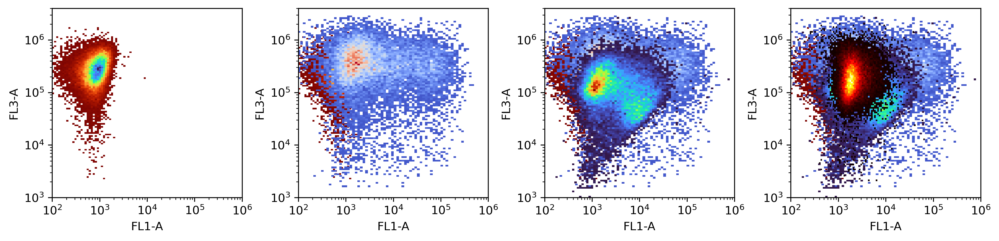

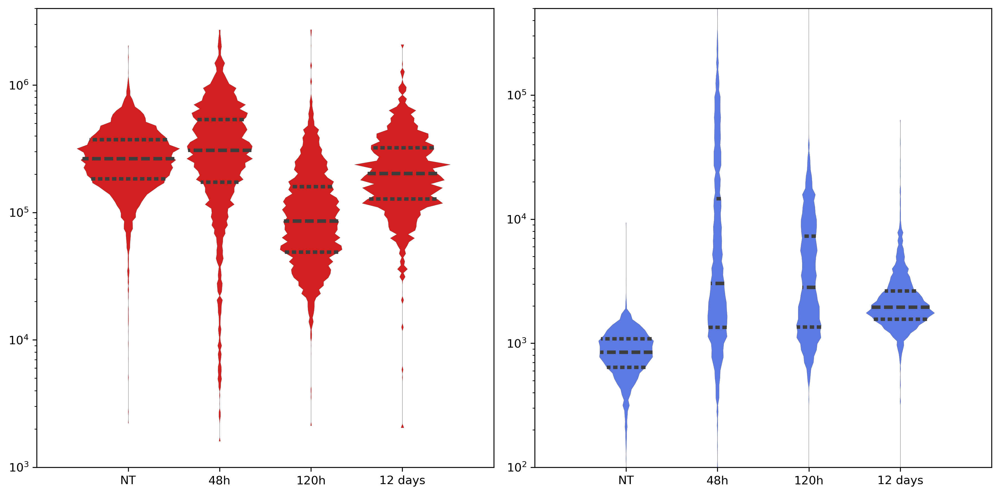

In [228]:
# VC1 D53
threshg =5000
fig, ax  = plt.subplots(1,4,figsize = (12,3),dpi = 300)
ax = ax.flatten()
d3 = files[tps[0]][fs[4]].loc[files[tps[0]][fs[4]][fps[1]]>threshg]
d1 = files[tps[2]][ctrl].loc[files[tps[2]][ctrl][fps[1]]>threshg]

d4 = files[tps[3]][stables[1]].loc[files[tps[3]][stables[1]][fps[1]]>threshg]
pp= 15
d2 = files[tps[1]][tts[pp]].loc[files[tps[1]][tts[pp]][fps[1]]>threshg]
overlaid_heatmaps(d1,d2,d3,d4,ax = ax)
thresh = 3000

for axe in ax:
    axe.set_xlim(100,1000000)
    axe.set_ylim(1000,4000000)

fig, ax  = plt.subplots(1,2,figsize = (12,6),dpi = 300)
ax = ax.flatten()
ovplots(d1,d2,d3,d4, ax = ax)
ax[0].set_ylim(1000,4000000)

(1000, 4000000)

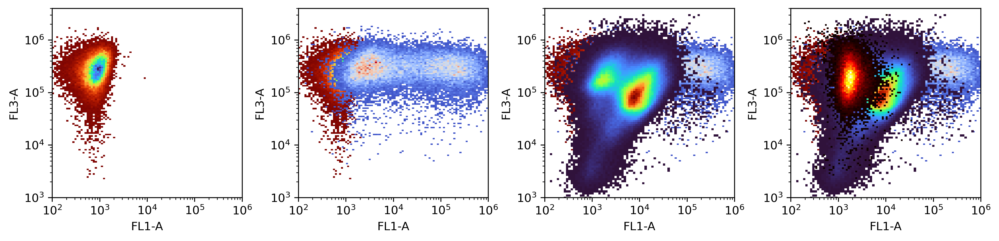

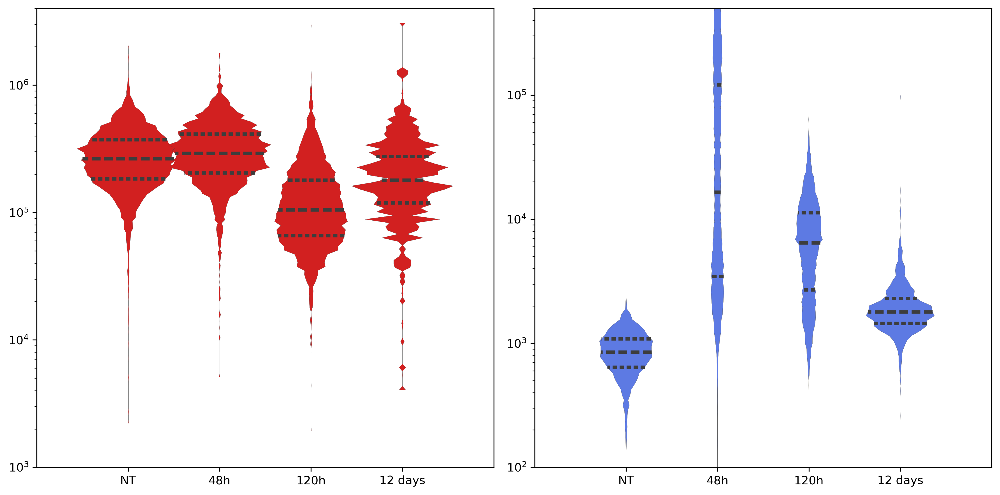

In [245]:

#vc1 d54
threshg =5000
thresh = 3000

fig, ax  = plt.subplots(1,4,figsize = (12,3),dpi = 300)
ax = ax.flatten()
d3 = files[tps[0]][fs[5]].loc[files[tps[0]][fs[5]][fps[1]]>threshg]
d1 = files[tps[2]][ctrl].loc[files[tps[2]][ctrl][fps[1]]>threshg]

d4 = files[tps[3]][stables[2]].loc[files[tps[3]][stables[2]][fps[1]]>threshg]
pp=23
d2 = files[tps[1]][tts[pp]].loc[files[tps[1]][tts[pp]][fps[1]]>threshg]
overlaid_heatmaps(d1,d2,d3,d4,ax = ax)

for axe in ax:
    axe.set_xlim(100,1000000)
    axe.set_ylim(1000,4000000)

fig, ax  = plt.subplots(1,2,figsize = (12,6),dpi = 300)
ax = ax.flatten()
ovplots(d1,d2,d3,d4, ax = ax)
ax[0].set_ylim(1000,4000000)

(1000, 4000000)

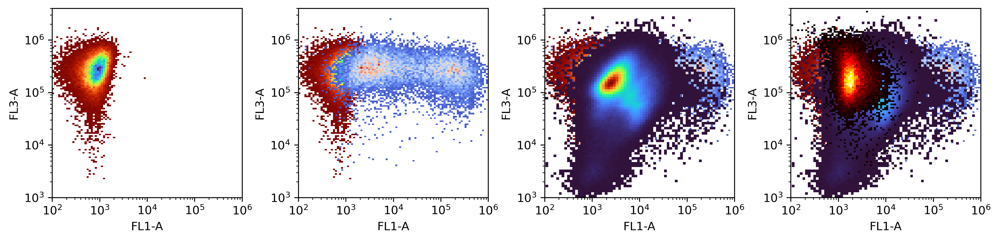

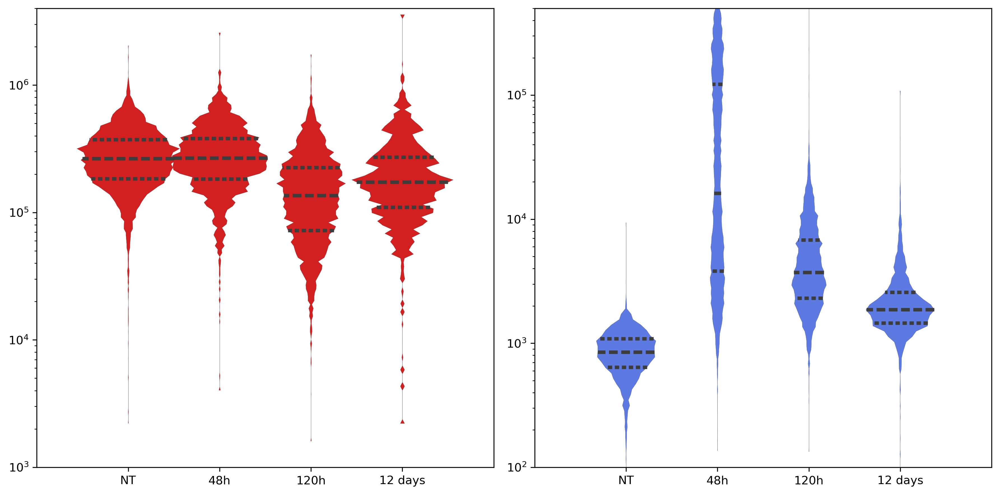

In [230]:

#vc1 d55
threshg =5000
thresh = 3000
fig, ax  = plt.subplots(1,4,figsize = (12,3),dpi = 300)
ax = ax.flatten()
d3 = files[tps[0]][fs[6]].loc[files[tps[0]][fs[6]][fps[1]]>threshg]
d1 = files[tps[2]][ctrl].loc[files[tps[2]][ctrl][fps[1]]>threshg]

d4 = files[tps[3]][stables[3]].loc[files[tps[3]][stables[3]][fps[1]]>threshg]
pp=24
d2 = files[tps[1]][tts[pp]].loc[files[tps[1]][tts[pp]][fps[1]]>threshg]
overlaid_heatmaps(d1,d2,d3,d4,ax = ax)

for axe in ax:
    axe.set_xlim(100,1000000)
    axe.set_ylim(1000,4000000)

fig, ax  = plt.subplots(1,2,figsize = (12,6),dpi = 300)
ax = ax.flatten()
ovplots(d1,d2,d3,d4, ax = ax)
ax[0].set_ylim(1000,4000000)


(1000, 4000000)

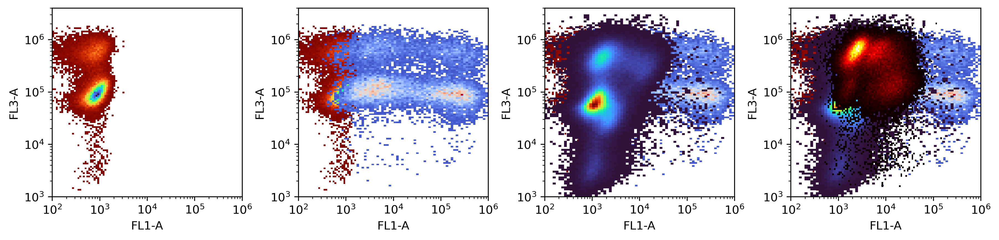

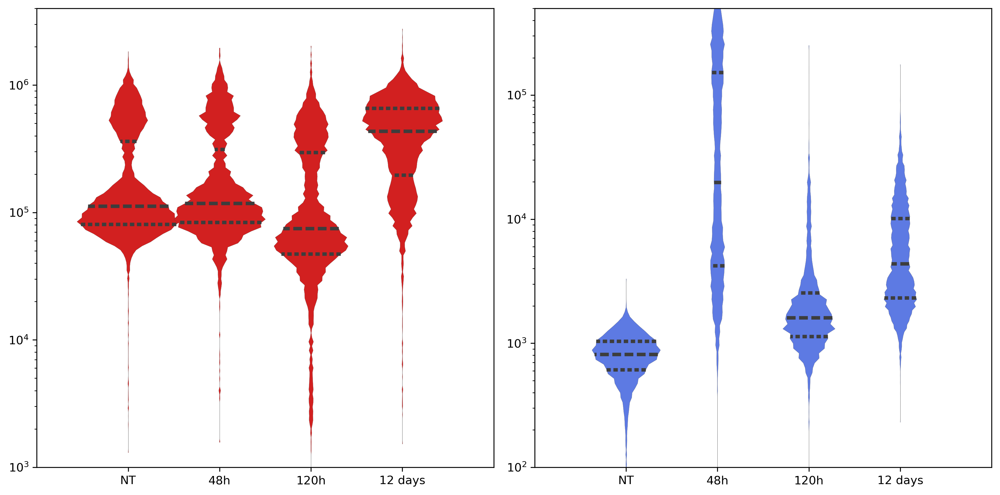

In [239]:
#vc4 d53
threshg =5000
thresh = 0
fig, ax  = plt.subplots(1,4,figsize = (12,3),dpi = 300)
ax = ax.flatten()
d3 = files[tps[0]][fs[-3]].loc[files[tps[0]][fs[-3]][fps[1]]>threshg]
d1 = files[tps[2]][ffs[1]].loc[files[tps[2]][ffs[1]][fps[1]]>threshg]

d4 = files[tps[3]][stables[6]].loc[files[tps[3]][stables[6]][fps[1]]>threshg]
pp=8
d2 = files[tps[1]][tts[pp]].loc[files[tps[1]][tts[pp]][fps[1]]>threshg]
overlaid_heatmaps(d1,d2,d3,d4,ax = ax)

for axe in ax:
    axe.set_xlim(100,1000000)
    axe.set_ylim(1000,4000000)

fig, ax  = plt.subplots(1,2,figsize = (12,6),dpi = 300)
ax = ax.flatten()
ovplots(d1,d2,d3,d4, ax = ax)
ax[0].set_ylim(1000,4000000)

(1000, 4000000)

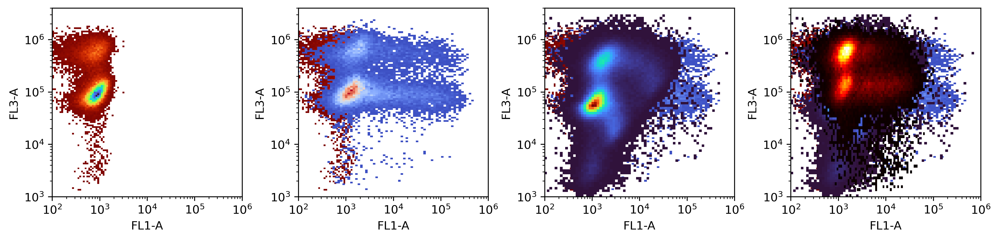

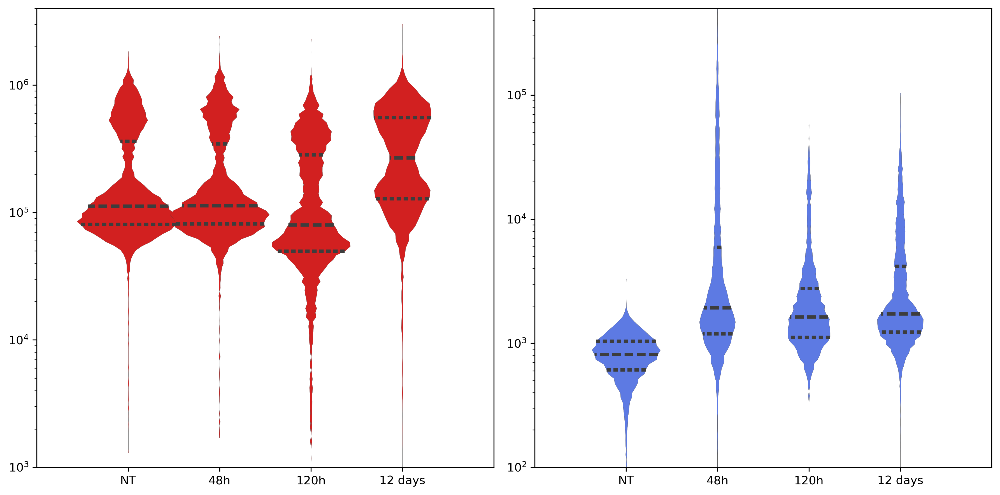

In [240]:
#vc4 d54
threshg =5000
thresh = 0
fig, ax  = plt.subplots(1,4,figsize = (12,3),dpi = 300)
ax = ax.flatten()
d3 = files[tps[0]][fs[-2]].loc[files[tps[0]][fs[-2]][fps[1]]>threshg]
d1 = files[tps[2]][ffs[1]].loc[files[tps[2]][ffs[1]][fps[1]]>threshg]

d4 = files[tps[3]][stables[7]].loc[files[tps[3]][stables[7]][fps[1]]>threshg]
pp=9
d2 = files[tps[1]][tts[pp]].loc[files[tps[1]][tts[pp]][fps[1]]>threshg]
overlaid_heatmaps(d1,d2,d3,d4,ax = ax)

for axe in ax:
    axe.set_xlim(100,1000000)
    axe.set_ylim(1000,4000000)

fig, ax  = plt.subplots(1,2,figsize = (12,6),dpi = 300)
ax = ax.flatten()
ovplots(d1,d2,d3,d4, ax = ax)
ax[0].set_ylim(1000,4000000)

(1000, 4000000)

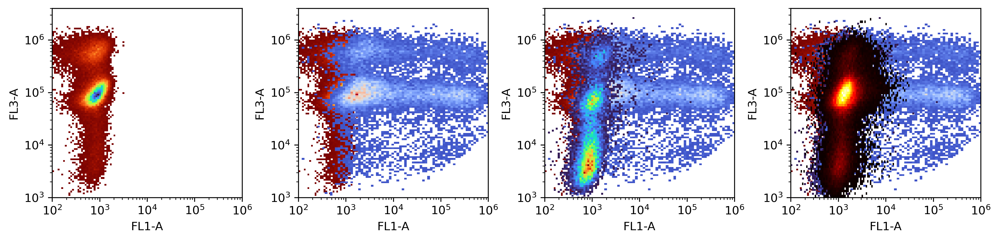

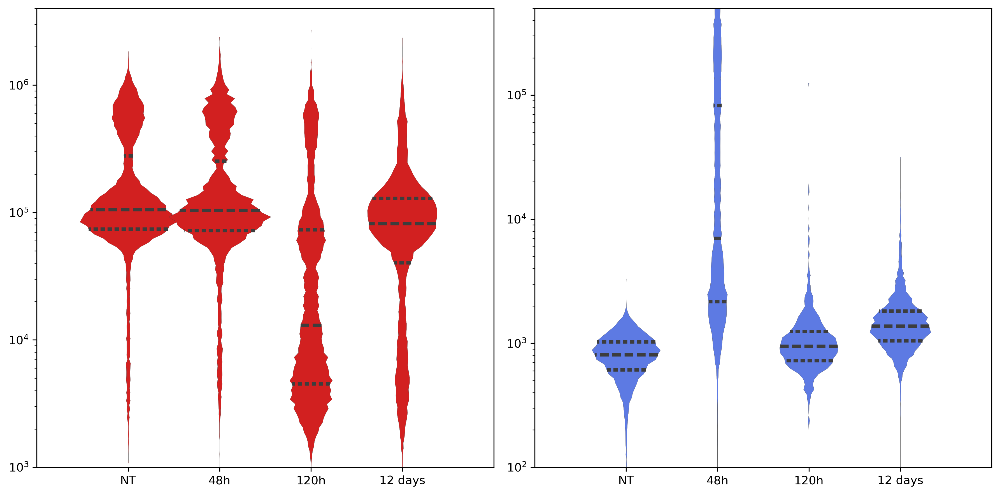

In [244]:
#vc4 d55
threshg =5000
thresh = 0
fig, ax  = plt.subplots(1,4,figsize = (12,3),dpi = 300)
ax = ax.flatten()
d3 = files[tps[0]][fs[-1]].loc[files[tps[0]][fs[-1]][fps[1]]>thresh]
d1 = files[tps[2]][ffs[1]].loc[files[tps[2]][ffs[1]][fps[1]]>thresh]

d4 = files[tps[3]][stables[8]].loc[files[tps[3]][stables[8]][fps[1]]>thresh]
pp=7
d2 = files[tps[1]][tts[pp]].loc[files[tps[1]][tts[pp]][fps[1]]>thresh]
overlaid_heatmaps(d1,d2,d3,d4,ax = ax)

for axe in ax:
    axe.set_xlim(100,1000000)
    axe.set_ylim(1000,4000000)

fig, ax  = plt.subplots(1,2,figsize = (12,6),dpi = 300)
ax = ax.flatten()
ovplots(d1,d2,d3,d4, ax = ax)
ax[0].set_ylim(1000,4000000)

In [233]:
fs

['vc1_fl2++D53_sort - 1_[2 Way] Data Source - 1.csv',
 'vc1_fl2++D54_sort_[2 Way] Data Source - 1.csv',
 'vc1_fl2++D55_sort - 1_[2 Way] Data Source - 1.csv',
 'vc1_fl2-3++D49_Data Source - 1.csv',
 'vc1_fl2-3++D53_sort_[2 Way] Data Source - 1.csv',
 'vc1_fl2-3++D54_sort  - 1_[2 Way] Data Source - 1.csv',
 'vc1_fl2-3++D55_sort_[2 Way] Data Source - 1.csv',
 'vc1_fl2-3++D56_sort_[2 Way] Data Source - 1.csv',
 'vc4_fl2++D53_sort  - 1_[2 Way] Data Source - 1.csv',
 'vc4_fl2++D54_sort  - 2_[2 Way] Data Source - 1.csv',
 'vc4_fl2++D55_sort  - 3_[2 Way] Data Source - 1.csv',
 'vc4_fl2-3++D49_Data Source - 1.csv',
 'vc4_fl2-3++D53_sort  - 1_[2 Way] Data Source - 1.csv',
 'vc4_fl2-3++D54_sort_[2 Way] Data Source - 1.csv',
 'vc4_fl2-3++D56_PREsort_Data Source - 1.csv']

In [199]:
stables

['VC1FL2++FL3++D56FL1+ - 1_[2 Way] Data Source - 1.csv',
 'VC1FL2++FL3++_D53FL1+_[2 Way] Data Source - 1.csv',
 'VC1FL2++FL3++_D54FL1+_[2 Way] Data Source - 1.csv',
 'VC1FL2++FL3++_D55FL1+ _[2 Way] Data Source - 1.csv',
 'VC1FL2++_D54FL1+_[2 Way] Data Source - 1.csv',
 'VC1FL2++_D55FL1+_[2 Way] Data Source - 1.csv',
 'VC4FL2++FL3++_D53FL1+_[2 Way] Data Source - 1.csv',
 'VC4FL2++FL3++_D54FL1+ - 1_[2 Way] Data Source - 1.csv',
 'VC4FL2++FL3++_D55FL1+_[2 Way] Data Source - 1.csv',
 'VC4FL2++_D53FL1+ - 1_[2 Way] Data Source - 1.csv',
 'VC4FL2++_D53FL1+_[2 Way] Data Source - 1.csv',
 'VC4FL2++_D54FL1+ - 1_[2 Way] Data Source - 1.csv',
 'VC4FL2++_D54FL1+ - 2_[2 Way] Data Source - 1.csv',
 'VC4FL2++_D54FL1+ - 3_[2 Way] Data Source - 1.csv']

In [220]:
def ovplots(d1,d2,d3,d4, ax = ax):

    dats = [d1,d2,d3,d4]
    cols = ["NT", "48h","120h","12 days"]
    new_df = pd.DataFrame()
    for kk,dat in enumerate(dats):
            if len(dat.loc[dat[fps[0]]>thresh][fps[2]])>1000:
                
                new_df[cols[kk]] = dat.loc[dat[fps[0]]>thresh][fps[2]]
            else:
                new_df[cols[kk]] = dat[fps[2]]
    
    sns.violinplot(new_df, color= reds[4], inner = "quart", width = 1.5,dodge = True,gap = 1.75,log_scale=True, 
                        cut = 0,alpha =1, density_norm="area",linewidth=0.1,bw_method = 0.0051,inner_kws={"linewidth":3},ax= ax[0])
    ax[0].set_xlim(-1,4)
    
    for kk,dat in enumerate(dats):
        new_df[cols[kk]] = dat[fps[0]]
    
    sns.violinplot(new_df, color= blues[6], inner = "quart", width =1.5,dodge = True,gap = 1.5,log_scale=True, 
                        cut = 0,alpha =1, density_norm="area",linewidth=0.1,bw_method = 0.0051,inner_kws={"linewidth":3},ax= ax[1])
    ax[1].set_xlim(-1,4)
    ax[1].set_ylim(100,500000)
    fig.tight_layout()

    return


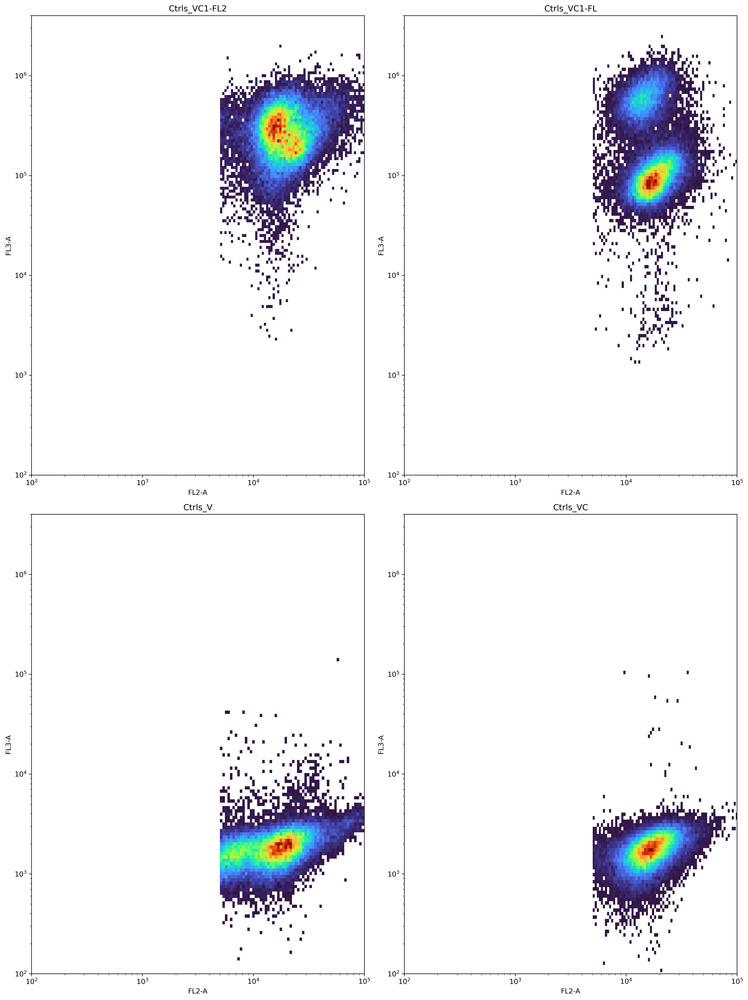

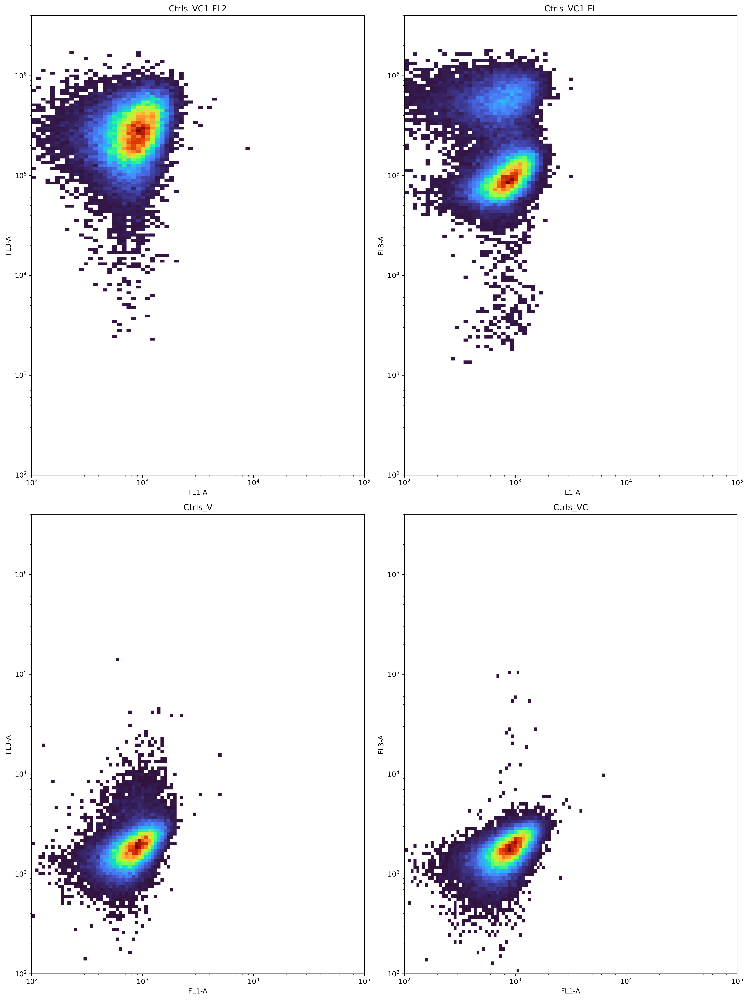

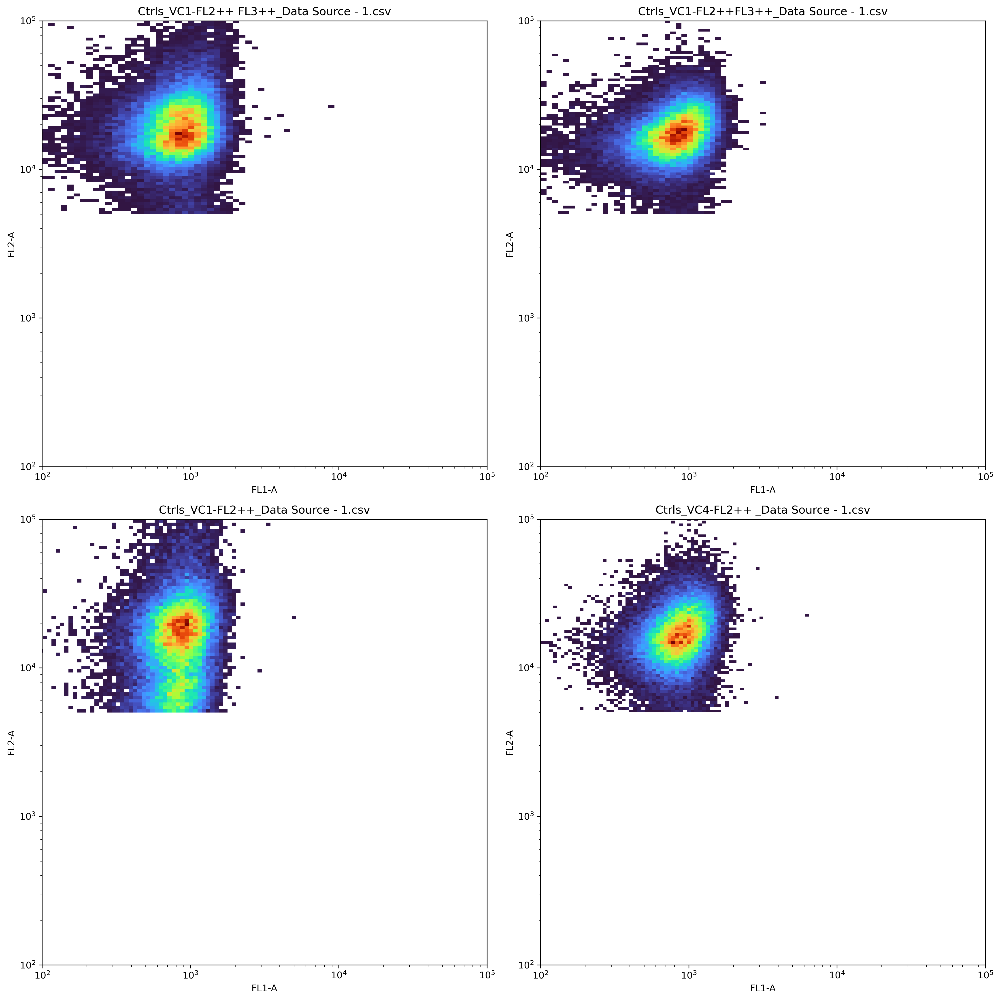

In [94]:
tp = 2
b=100
thresh = 5000
fs = [x for x in files[tps[tp]].keys()]

fig,ax = plt.subplots(2,2,figsize =(15,20),dpi = 300)
ax = ax.flatten()
for jj,f in enumerate(fs):
    threshed_data = files[tps[tp]][f].loc[files[tps[tp]][f][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[1], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )
    # sns.histplot(
    #    data=files[kk], x=fps[1], y=fps[2],
    #     bins=b, discrete=(False, False), log_scale=(True, True),
    #     cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    # )
    ax[jj].set_title(str(tps[tp] + "_" + f[0:-28]) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

fig,ax = plt.subplots(2,2,figsize =(15,20),dpi = 300)
ax = ax.flatten()
for jj,f in enumerate(fs):
    threshed_data = files[tps[tp]][f].loc[files[tps[tp]][f][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[0], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )
    # sns.histplot(
    #    data=files[kk], x=fps[1], y=fps[2],
    #     bins=b, discrete=(False, False), log_scale=(True, True),
    #     cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    # )
    ax[jj].set_title(str(tps[tp] + "_" + f[0:-28]) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

fig,ax = plt.subplots(2,2,figsize =(15,15),dpi = 300)
ax = ax.flatten()
for jj,f in enumerate(fs):
    threshed_data = files[tps[tp]][f].loc[files[tps[tp]][f][fps[1]]>thresh]

    sns.histplot(
   data=threshed_data, x=fps[0], y=fps[1],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )
    # sns.histplot(
    #    data=files[kk], x=fps[1], y=fps[2],
    #     bins=b, discrete=(False, False), log_scale=(True, True),
    #     cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    # )
    ax[jj].set_title(str(tps[tp] + "_" + f) )
    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,100000)
fig.tight_layout()

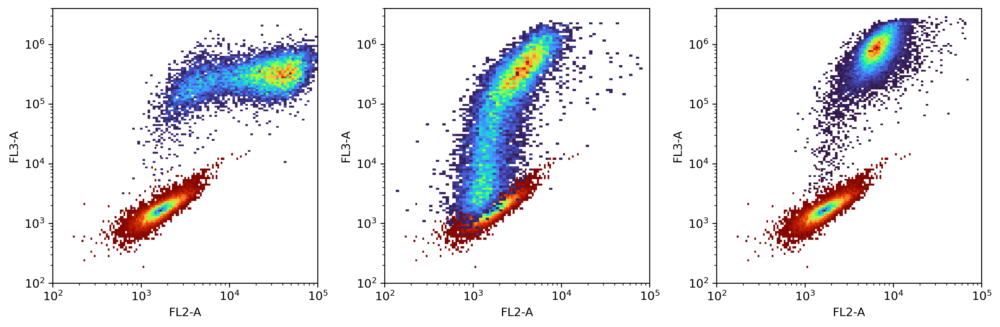

In [166]:
#vc2 fl3+fl2+
b=100
clones = [x for x in range(6,9)]

fig,ax = plt.subplots(1,3,figsize =(12,4),dpi = 300)
ax = ax.flatten()
for jj,kk in enumerate(clones):
    # print(jj)
    sns.histplot(
   data=files[-1], x=fps[1], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo_r", ax = ax[jj]
    )
    sns.histplot(
       data=files[kk], x=fps[1], y=fps[2],
        bins=b, discrete=(False, False), log_scale=(True, True),
        cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )

    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

0
1
2
3
4
5


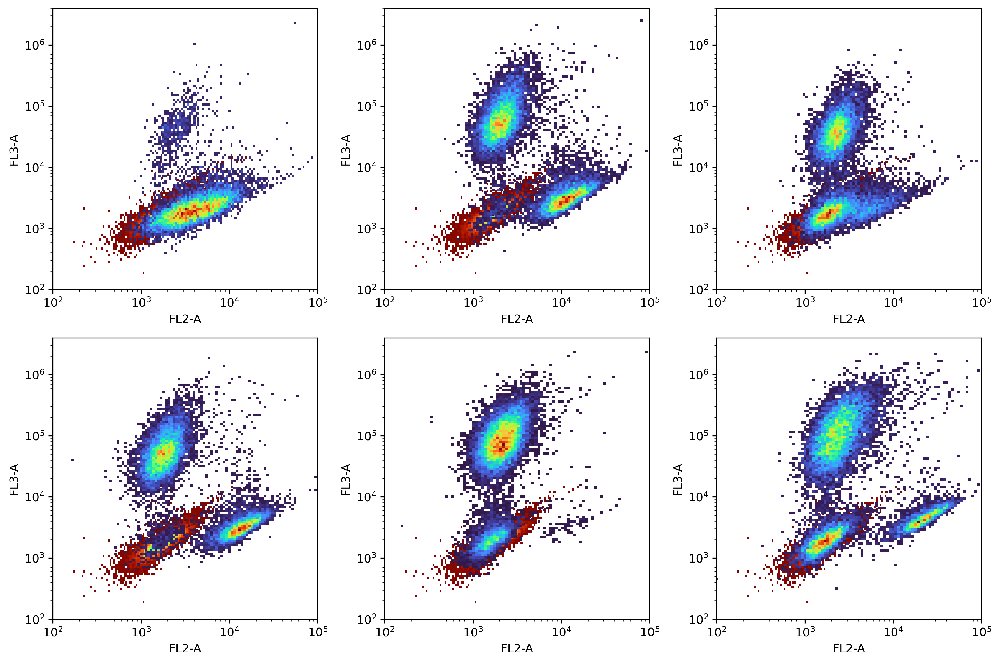

In [149]:
#VC4 FL2+

b=100
clones = [x for x in range(11,17)]
fig,ax = plt.subplots(2,3,figsize =(12,8),dpi = 300)
ax = ax.flatten()
for jj,kk in enumerate(clones):
    print(jj)
    sns.histplot(
   data=files[-1], x=fps[1], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo_r", ax = ax[jj]
    )
    sns.histplot(
       data=files[kk], x=fps[1], y=fps[2],
        bins=b, discrete=(False, False), log_scale=(True, True),
        cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )

    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

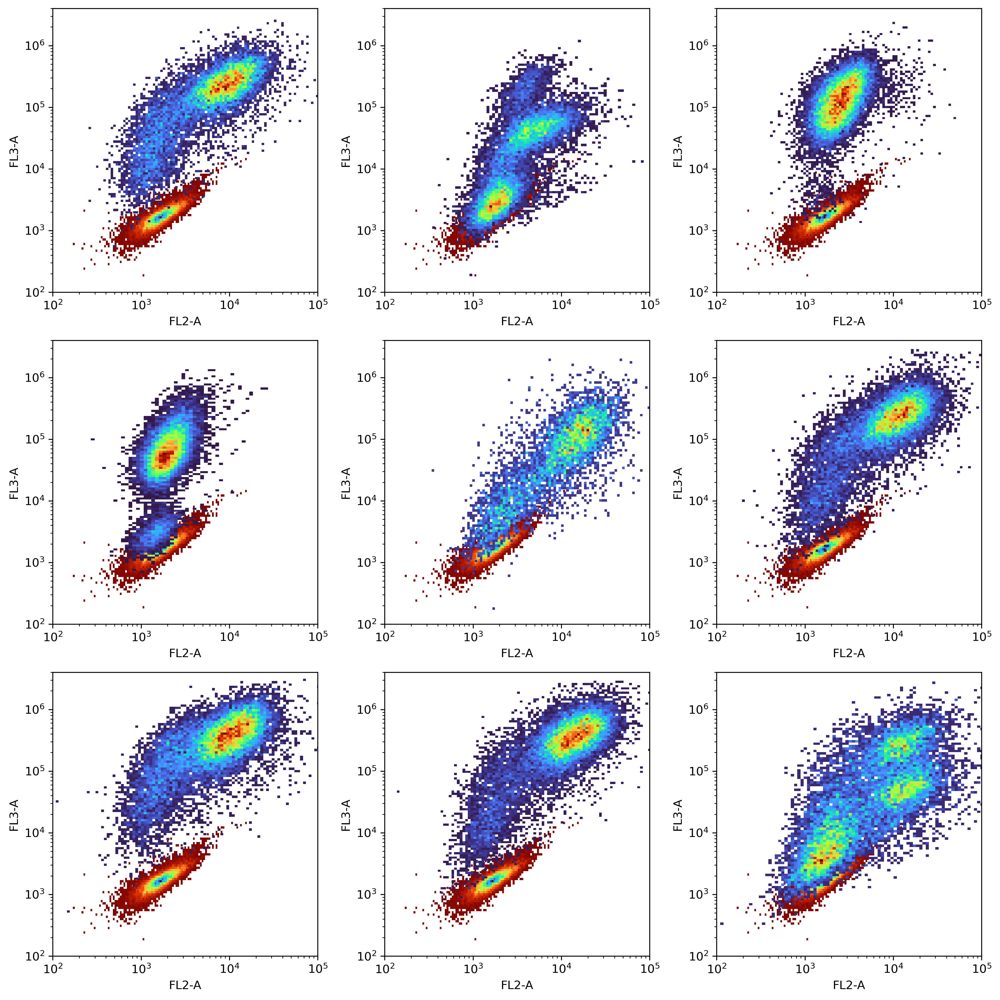

In [155]:
#VC4 FL2+ FL3+

b=100
clones = [x for x in range(17,24)]
clones.insert(-1,10)
clones.insert(-1,9)
fig,ax = plt.subplots(3,3,figsize =(12,12),dpi = 300)
ax = ax.flatten()
for jj,kk in enumerate(clones):
    # print(jj)
    sns.histplot(
   data=files[-1], x=fps[1], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo_r", ax = ax[jj]
    )
    sns.histplot(
       data=files[kk], x=fps[1], y=fps[2],
        bins=b, discrete=(False, False), log_scale=(True, True),
        cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )

    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

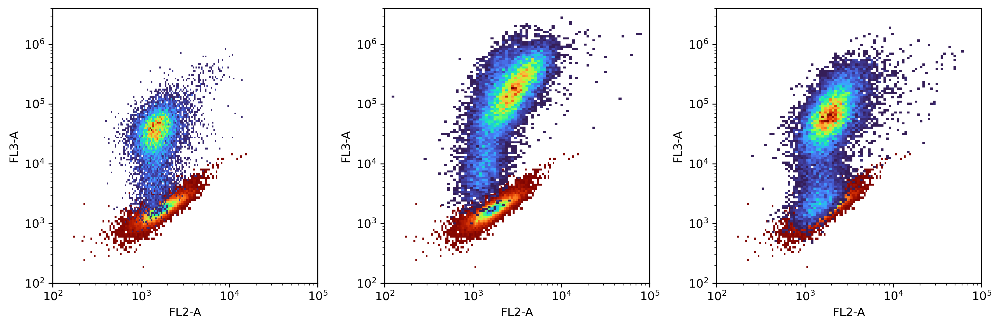

In [158]:
#vc6 fl3+fl2+
b=100
clones = [x for x in range(24,27)]

fig,ax = plt.subplots(1,3,figsize =(12,4),dpi = 300)
ax = ax.flatten()
for jj,kk in enumerate(clones):
    # print(jj)
    sns.histplot(
   data=files[-1], x=fps[1], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo_r", ax = ax[jj]
    )
    sns.histplot(
       data=files[kk], x=fps[1], y=fps[2],
        bins=b, discrete=(False, False), log_scale=(True, True),
        cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )

    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

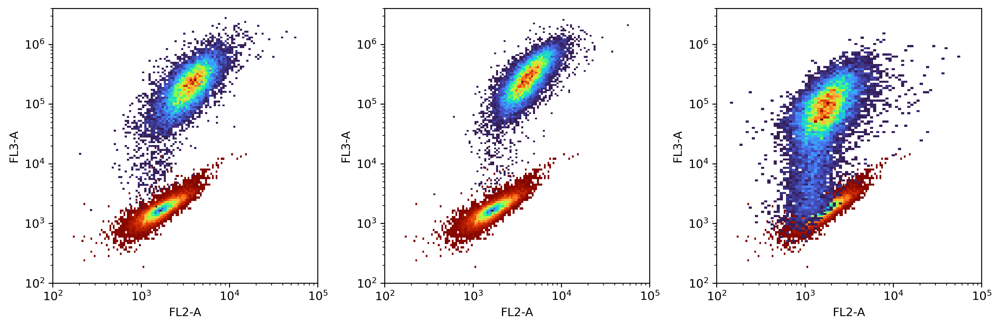

In [160]:
#vc7 fl3+fl2+
b=100
clones = [x for x in range(27,30)]

fig,ax = plt.subplots(1,3,figsize =(12,4),dpi = 300)
ax = ax.flatten()
for jj,kk in enumerate(clones):
    # print(jj)
    sns.histplot(
   data=files[-1], x=fps[1], y=fps[2],
    bins=b, discrete=(False, False), log_scale=(True, True),
    cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo_r", ax = ax[jj]
    )
    sns.histplot(
       data=files[kk], x=fps[1], y=fps[2],
        bins=b, discrete=(False, False), log_scale=(True, True),
        cbar=False, cbar_kws=dict(shrink=.75),cmap= "turbo", ax = ax[jj]
    )

    ax[jj].set_xlim(100,100000)
    ax[jj].set_ylim(100,4000000)
fig.tight_layout()

In [21]:
def quad(data,chan1,chan2,thresh1,thresh2,plot =False, title =None,colos = ["grey", greens[2],reds[2],yellows[2]]):
    q1 = data.loc[(data[chan1]<thresh1) & (data[chan2]<thresh2)]
    q2 = data.loc[(data[chan1]<thresh1) & (data[chan2]>thresh2)]
    q3 = data.loc[(data[chan1]>thresh1) & (data[chan2]<thresh2)]
    q4 = data.loc[(data[chan1]>thresh1) & (data[chan2]>thresh2)]
    quads = [q1,q2,q3,q4]
    ratios = [qq[chan1].count()/data[chan1].count() for qq in quads]
    if plot == True:
        fig, ax = plt.subplots(1,1, figsize = (4,4), dpi = 200)


        kk =0
        
        fig1, axes = plt.subplots(4,3, figsize = (9,9), dpi = 400)
        axes = axes.flatten()
        for qq,colo in zip(quads,colos):
            ax.scatter(qq[chan2],qq[chan1],c = colo,alpha = 0.05,s = 0.1)
            ax.set_xlim(100,1000000)
            ax.set_xscale('log')
            ax.set_xlabel(chan1)
            ax.set_ylim(100,1000000)
            ax.set_yscale('log')
            ax.set_ylabel(chan2)
            ax.legend(labels = [(str(round(tt*100,1))+"%") for tt in ratios],loc ="lower right",labelcolor=colos,frameon = False,handletextpad=0.1,borderaxespad = 0.1)
            for chan in ['FL2-A', 'FL3-A','FL6-A']:
                sns.histplot(qq[chan],ax = axes[kk],color = colo,log_scale =True,stat = 'density', fill = fu, alpha = alp,bins =1000)
                axes[kk].set_xlim(1,2000000)
                kk+=1
                
                # plt.show(block=False)
                # plt.close()
                # gc.collect()
                
                # clear_output()

            # break
        ax.axvline(x = thresh1,color = 'k',lw = 0.5)
        ax.axhline(y = thresh2,color = 'k',lw = 0.5)
        ax.set_title(title)
        fig.tight_layout()
        fig1.tight_layout()
        print(title)
        fig.savefig(str(outpath)+ f'{"2D_"+title}.png')

        fig1.savefig(str(outpath)+ f'{"Dist_"+title}.png')

    return(quads,ratios)

D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

VC6-SORTED_FL3+


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

VC4_[96 Well]


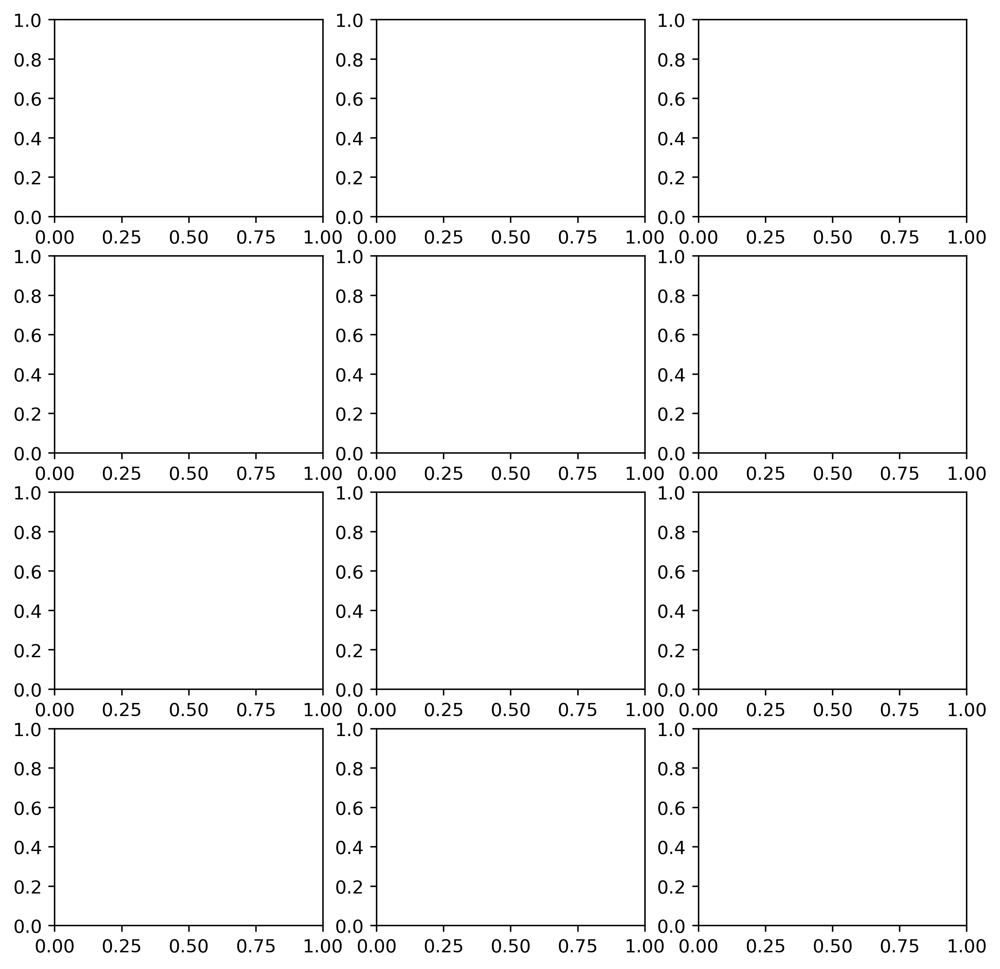

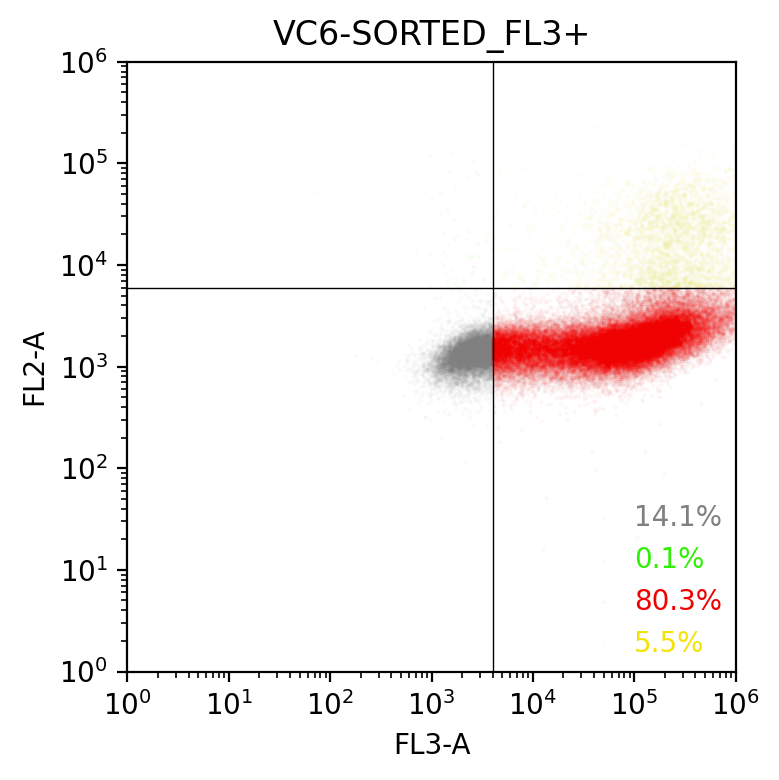

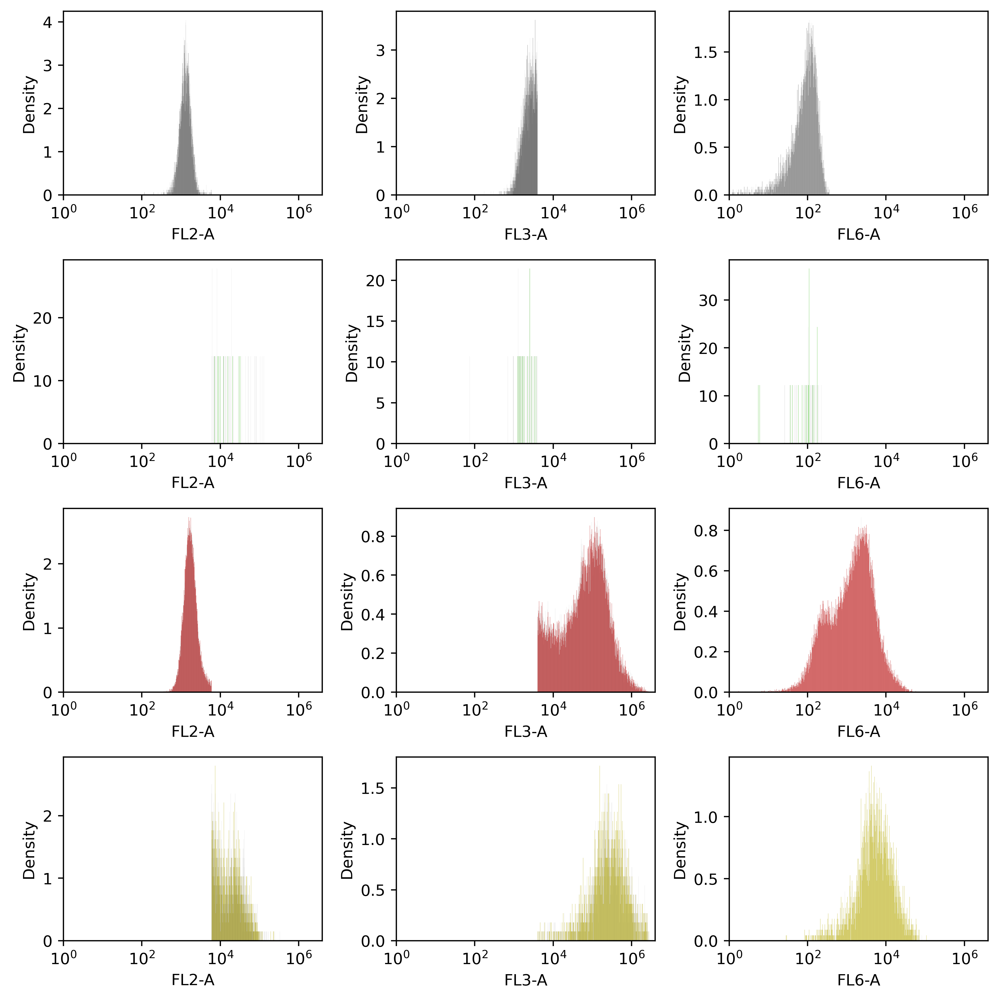

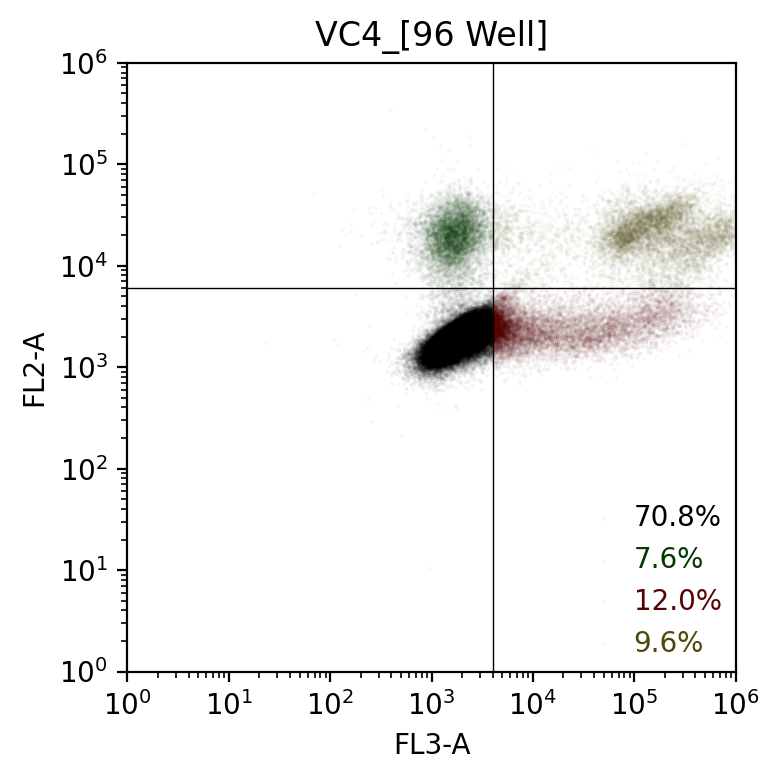

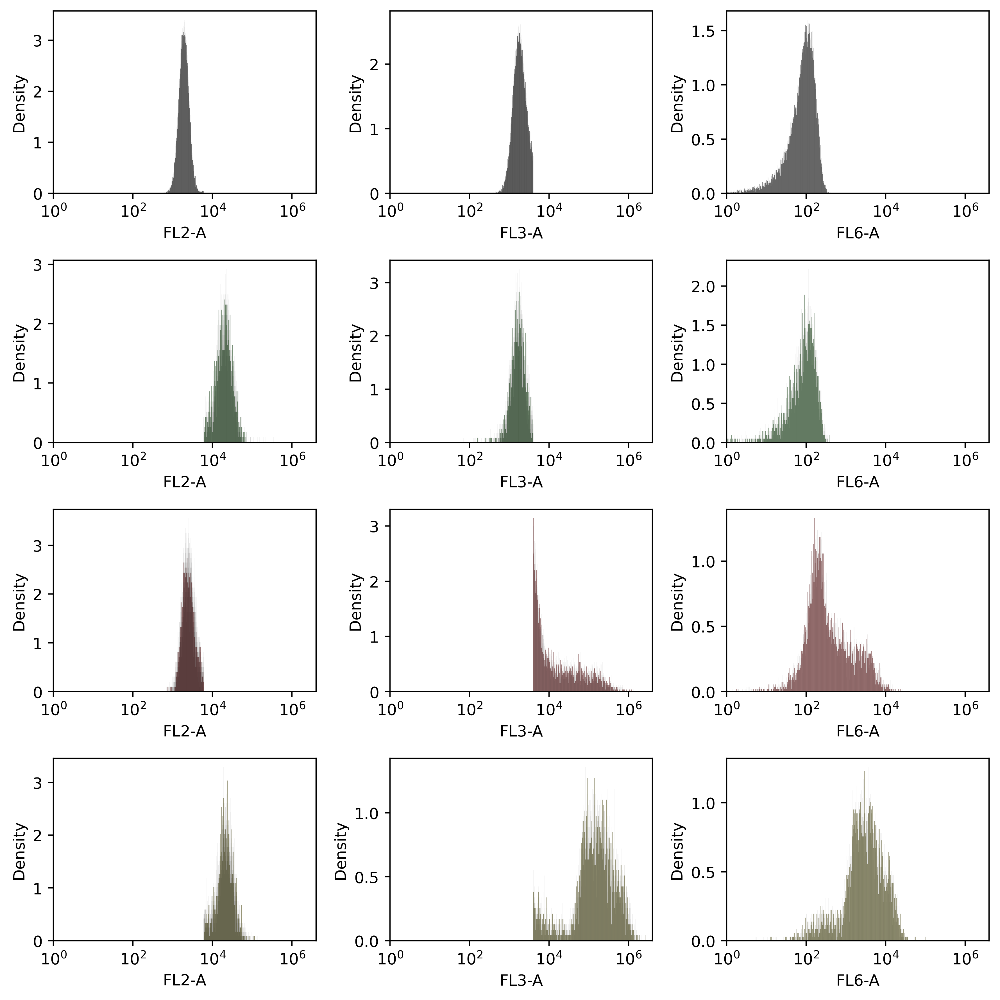

In [20]:
chan1 = "FL3-A"
chan2 = "FL2-A"
thresh1 = 4000
thresh2 = 6000
kk = 4
alp = 0.5
fig1, axes = plt.subplots(4,3, figsize = (9,9), dpi = 400)
axes = axes.flatten()
colos = ["grey", greens[kk],reds[kk],yellows[kk]]
quads,ratios = quad(files[kk],chan1,chan2,thresh1,thresh2,plot = True,title = filenames[kk][:-20],colos =colos)
kk = 2
colos = ["k", greens[kk-2],reds[kk-2],yellows[kk-2]]
quads,ratios = quad(files[kk],chan1,chan2,thresh1,thresh2,plot = True,title = filenames[kk][:-20],colos =colos)


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

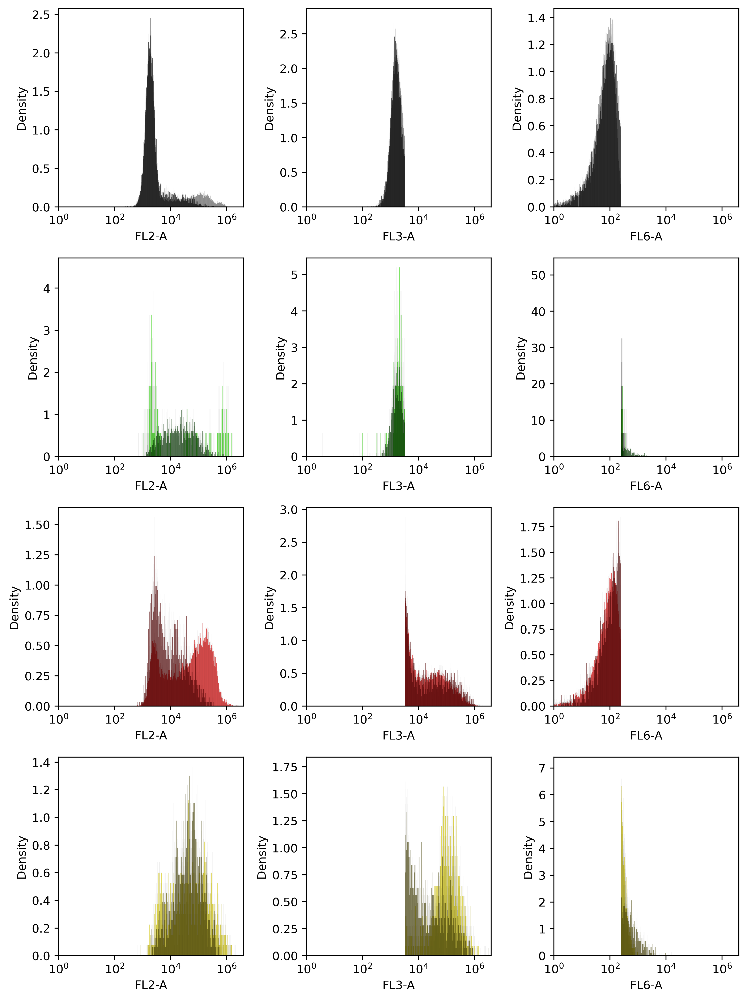

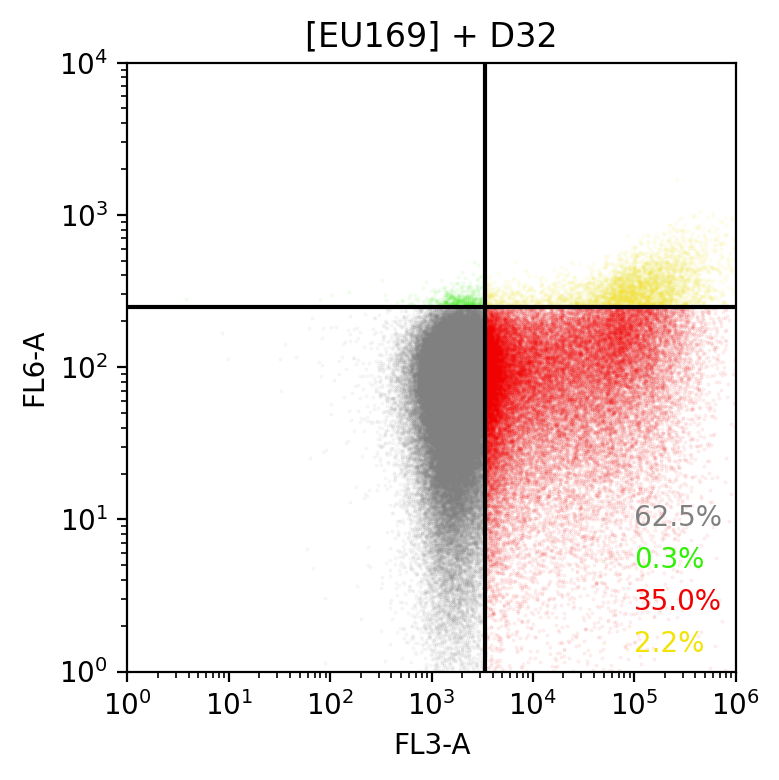

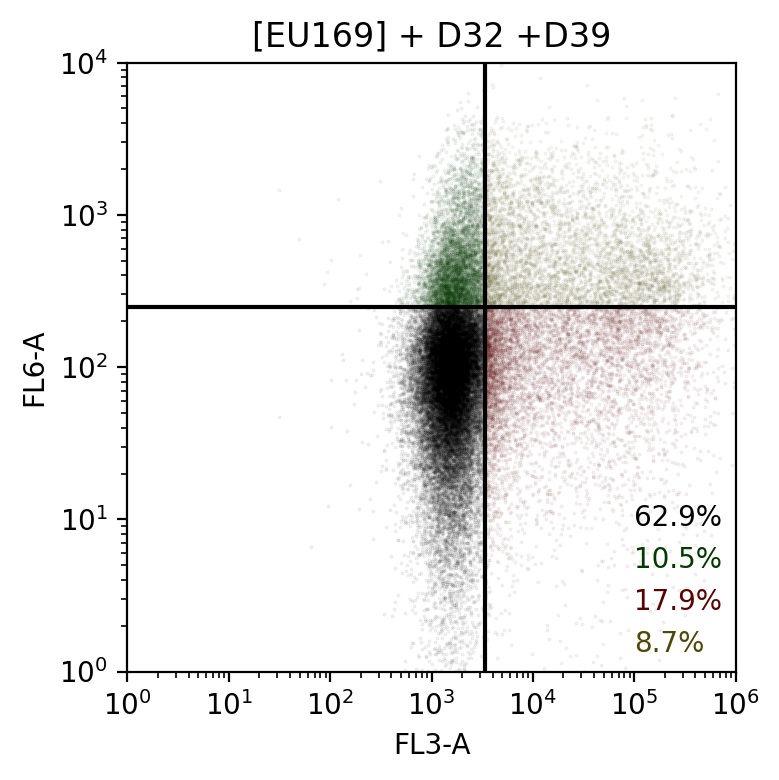

In [236]:
chan1 = "FL3-A"
chan2 = "FL6-A"
thresh1 = 3400
thresh2 = 250
kk = 4
alp = 0.65
fig1, axes = plt.subplots(4,3, figsize = (9,12), dpi = 400)
axes = axes.flatten()
colos = ["grey", greens[kk],reds[kk],yellows[kk]]
quads,ratios = quad(files[kk],chan1,chan2,thresh1,thresh2,plot = True,axes =axes,title = filenames[kk][:-20],colos =colos)
kk = 2
colos = ["k", greens[kk-2],reds[kk-2],yellows[kk-2]]
quads,ratios = quad(files[kk],chan1,chan2,thresh1,thresh2,plot = True, axes =axes,title = filenames[kk][:-20],colos =colos)

In [7]:
def get_stats(quads,ratios):
    fps = ["FL2-A","FL3-A","FL6-A"]
    means = []
    stds = []
    cvs = []
    for chan in fps:
        ms = [np.mean(qq[chan]) for qq in quads]
        ss = [np.std(qq[chan]) for qq in quads]
        cs = [ss[kk]/ms[kk]for kk in range(len(ms))]
        means.append(ms)
        stds.append(ss)
        cvs.append(cs)
    return(means,stds,cvs)
def bs_ratios(data,chan1,chan2,thresh1,thresh2,n_bs =1000,size_bs = 300):
    bs_ratios = []
    for gg in range(n_bs):
        babs = data.sample(size_bs, replace=True)
        q1 = babs.loc[(babs[chan1]<thresh1) & (babs[chan2]<thresh2)]
        q2 = babs.loc[(babs[chan1]<thresh1) & (babs[chan2]>thresh2)]
        q3 = babs.loc[(babs[chan1]>thresh1) & (babs[chan2]<thresh2)]
        q4 = babs.loc[(babs[chan1]>thresh1) & (babs[chan2]>thresh2)]
        quads = [q1,q2,q3,q4]
        bs_ratios.append([qq[chan1].count()/babs[chan1].count() for qq in quads])

    return(bs_ratios)
def get_corr(quads,ratios,chan1,chan2):
    fps = ["FL2-A","FL3-A","FL6-A"]
    means = []
    stds = []
    cvs = []
    for chan in fps:
        ms = [scipy.stats.kendalltau(qq[chan1],qq[chan2])[0] for qq in quads]
        ss = [scipy.stats.spearmanr(qq[chan1],qq[chan2])[0] for qq in quads]
        cs = [scipy.stats.pearsonr(qq[chan1],qq[chan2])[0] for qq in quads]
        means.append(ms)
        stds.append(ss)
        cvs.append(cs)
    return(means,stds,cvs)

D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D21+D27


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D21+EU169 +D17


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D21+EU169 +D30


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: i

D21+EU169


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D21


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D22+D26


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D22


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D23+ EU169


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D23+D27-2


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D23+D27


C:\Users\cheta\AppData\Local\Temp\ipykernel_11364\4046694230.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,1, figsize = (4,4), dpi = 200)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version

D23+EU169 +D17


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D23


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D24+D26


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D24+EU169 +D15


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D24+EU169


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D24


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D25+D26


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D25


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D26


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D34+EU169


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D9+EU169 +D17


D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
D:\Anaconda\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values 

D9+EU169


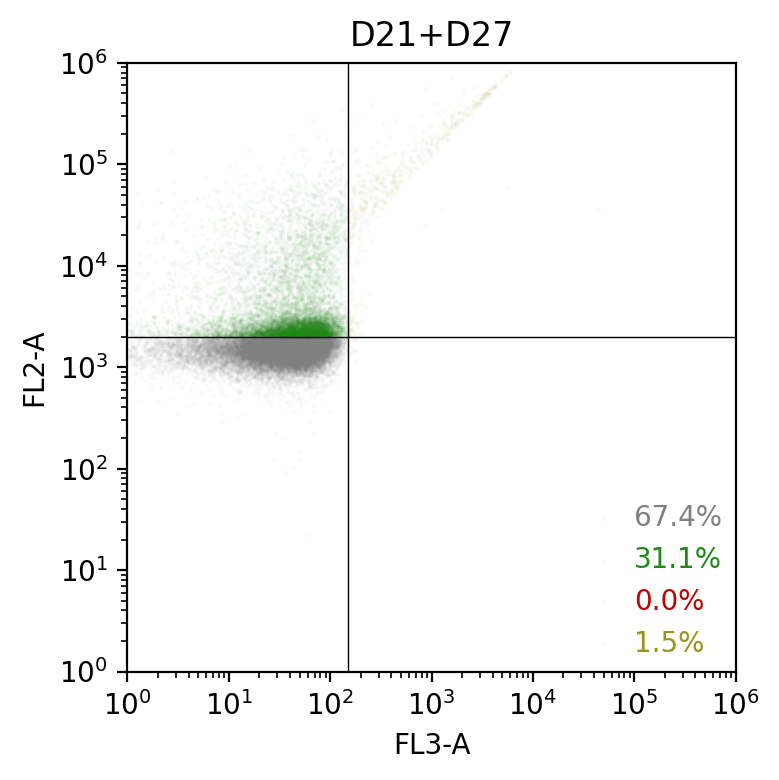

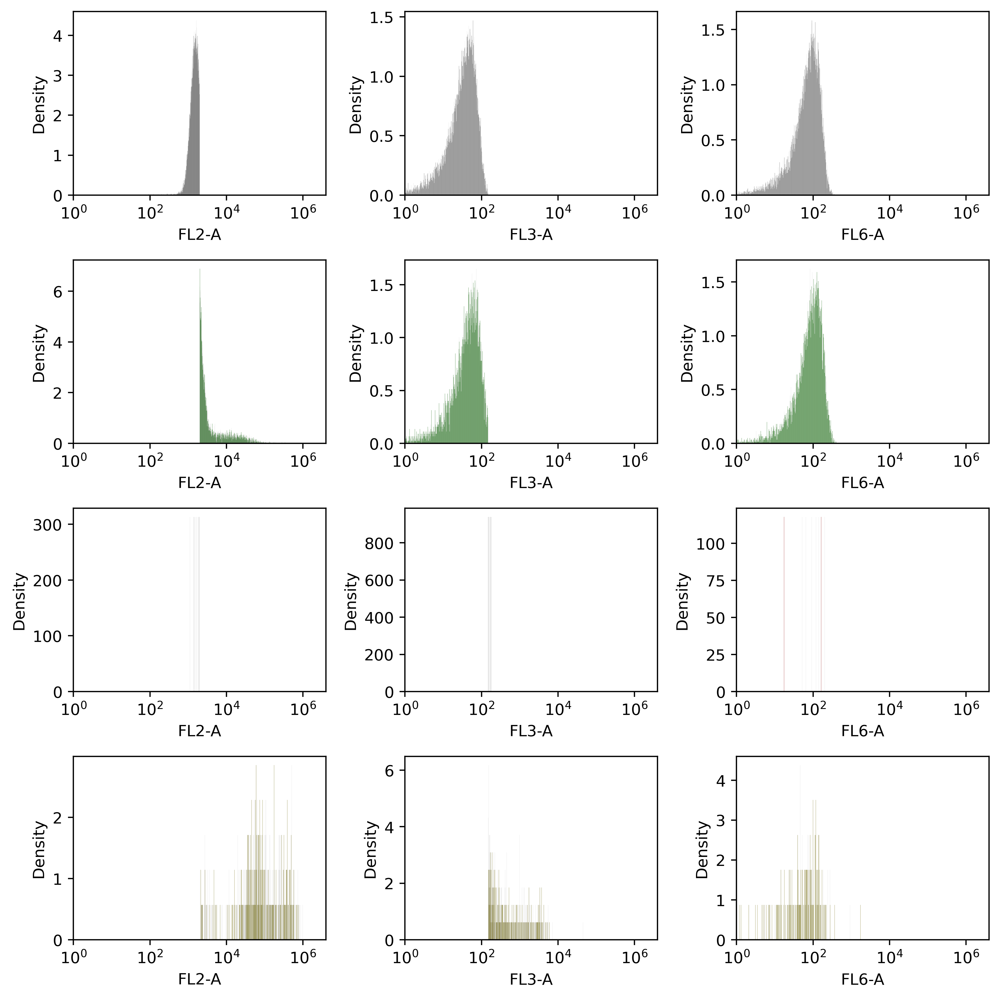

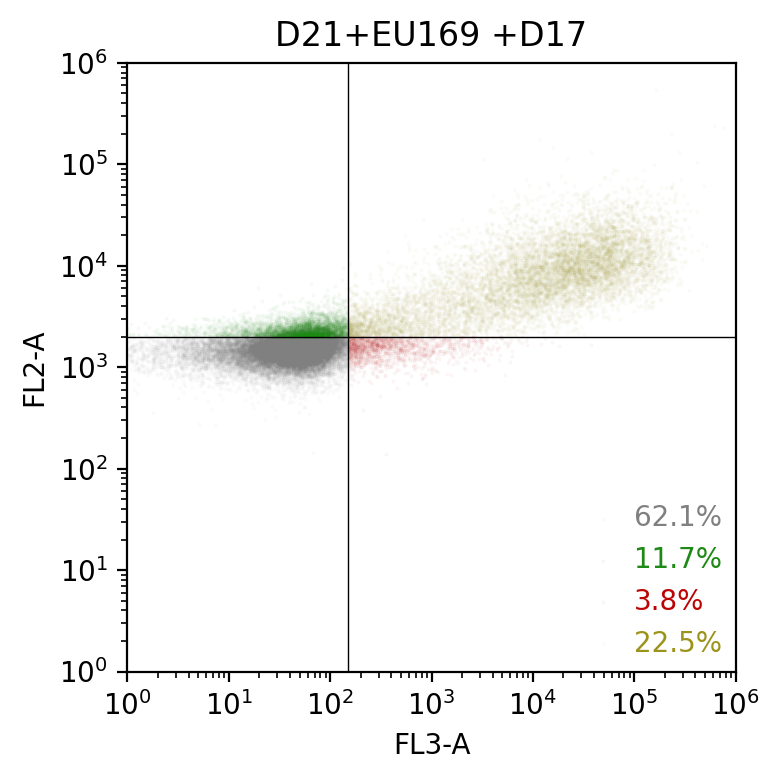

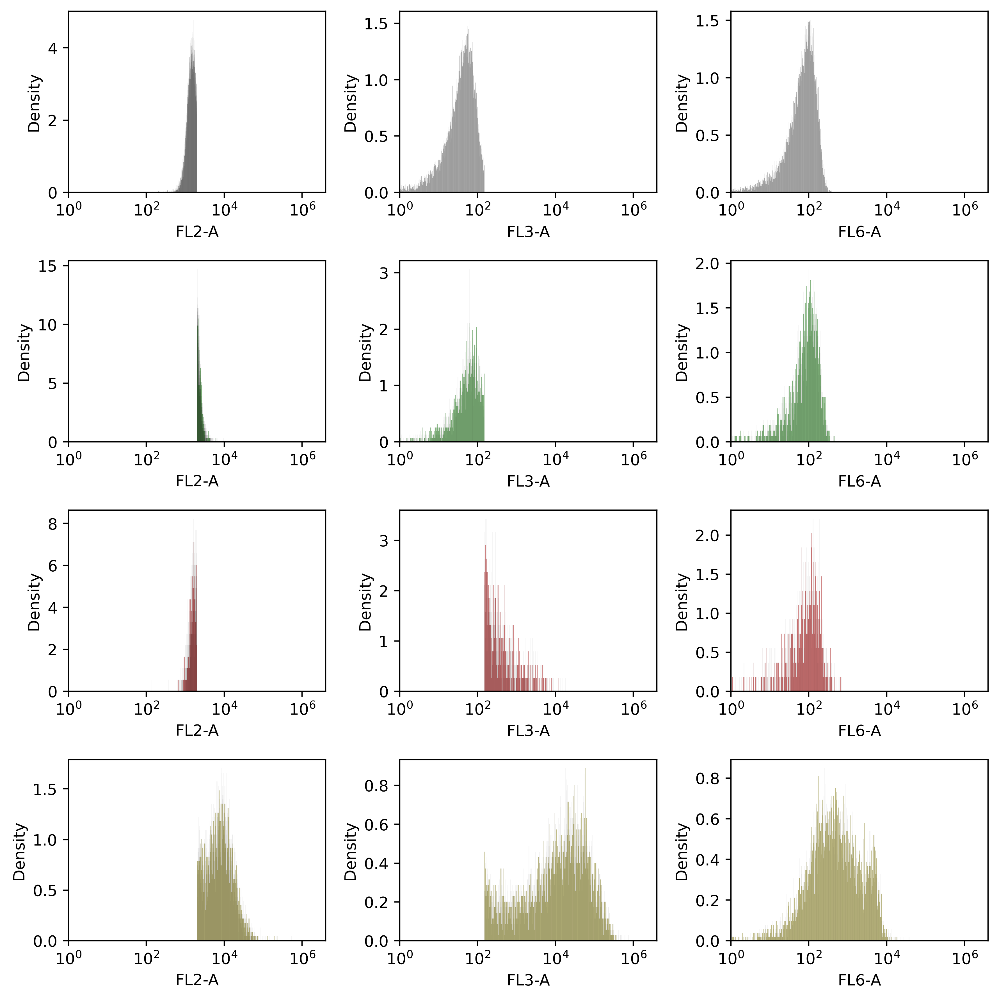

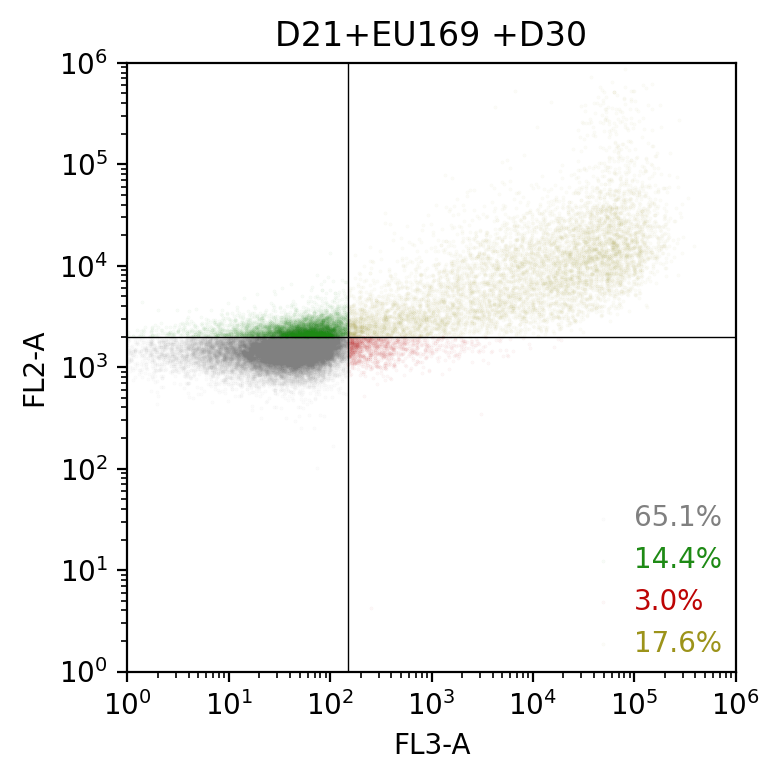

...

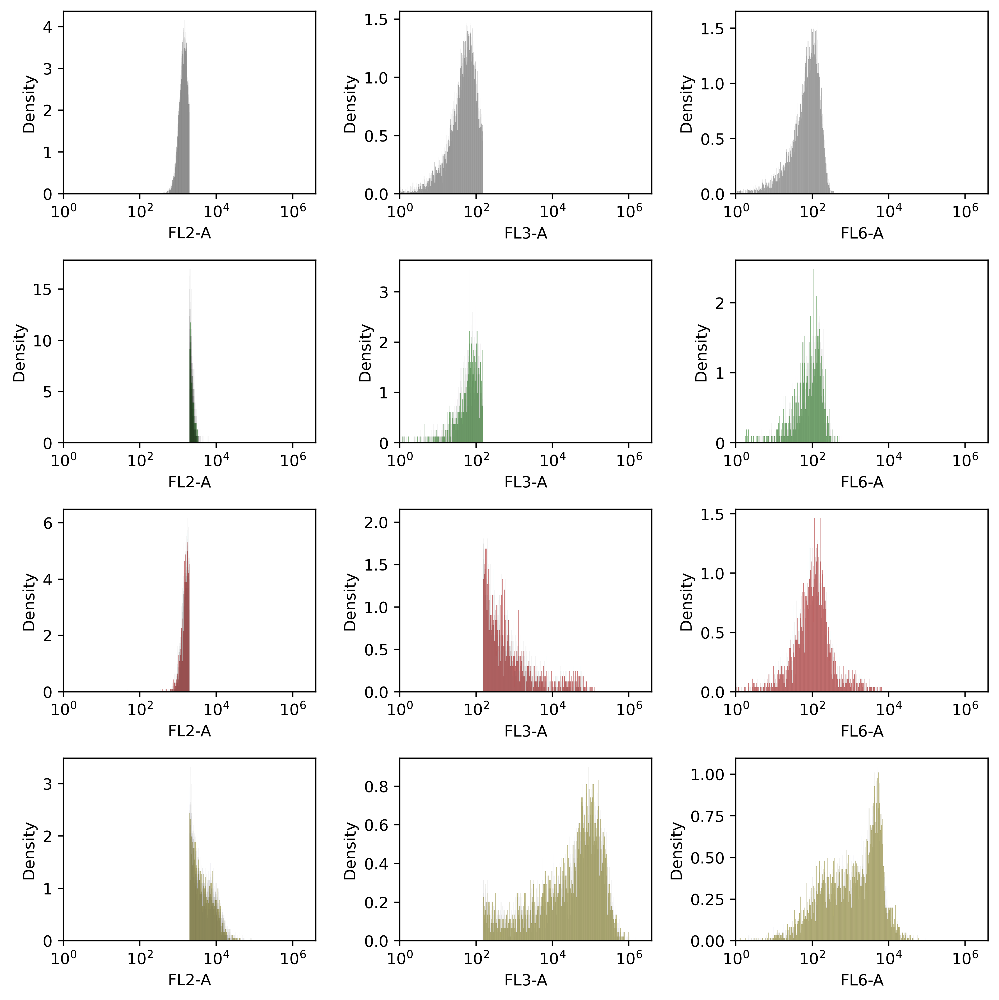

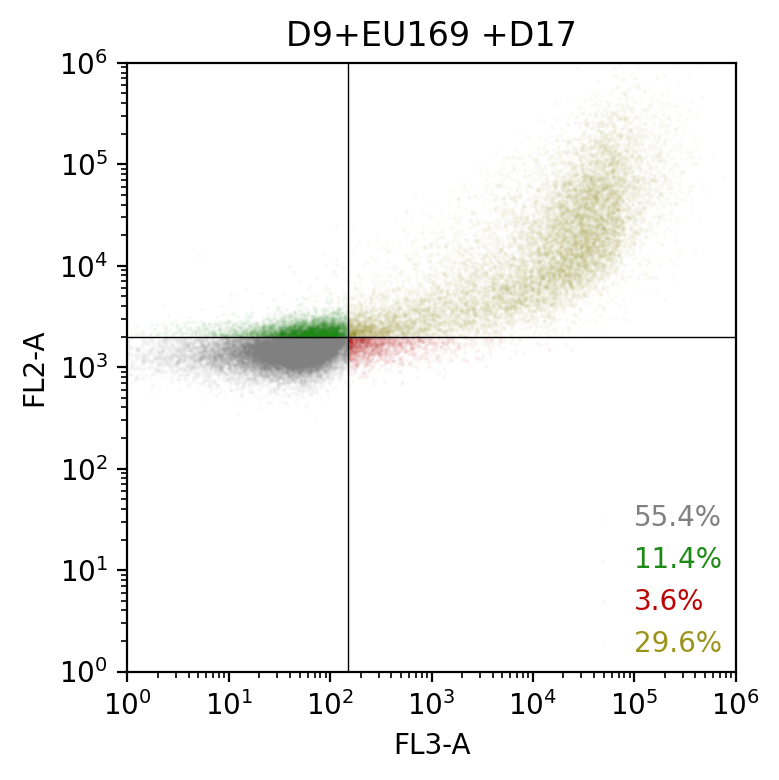

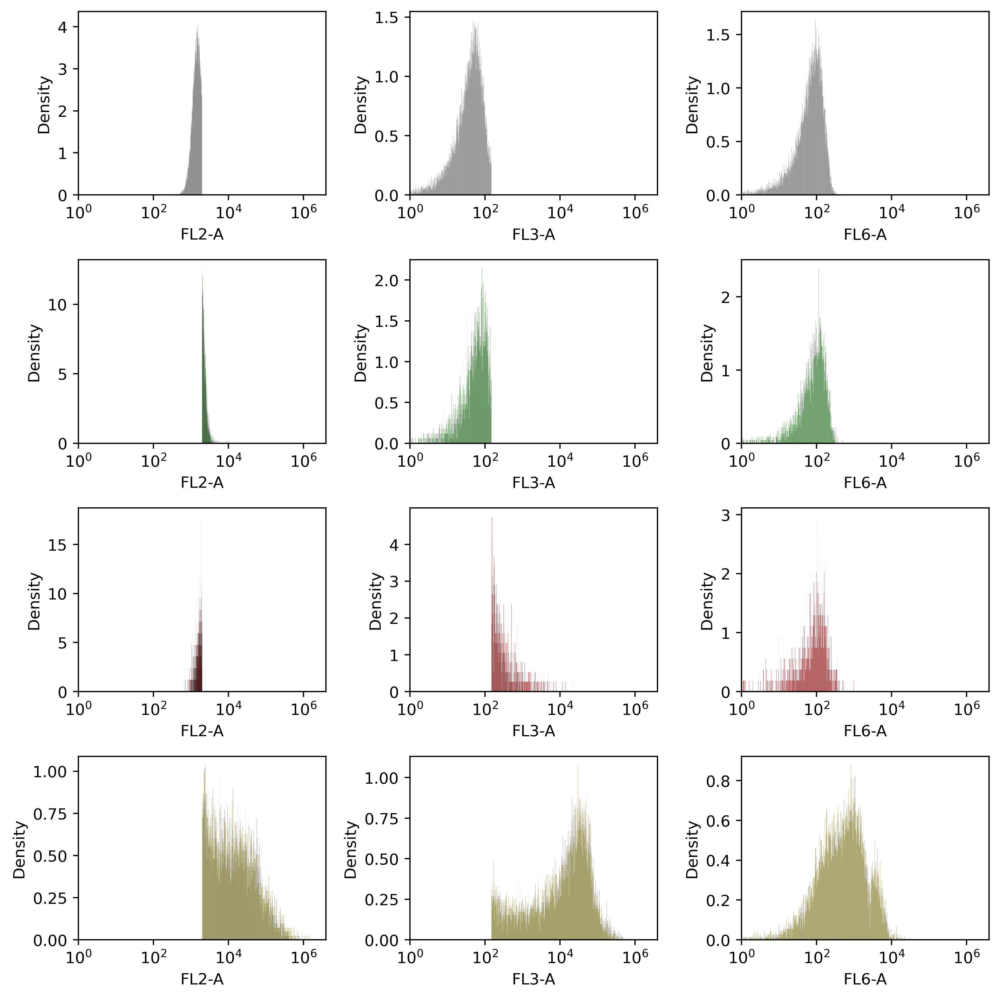

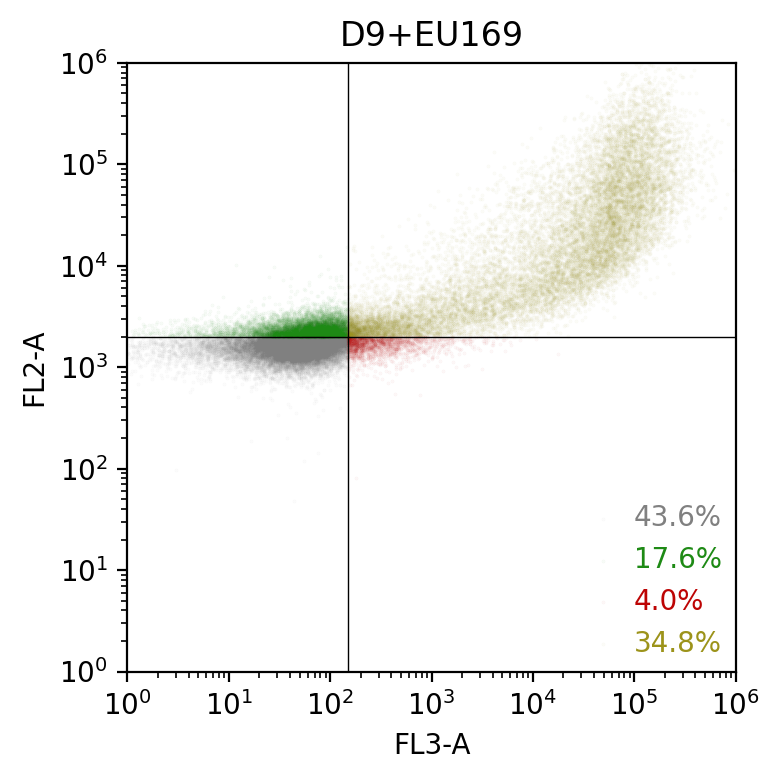

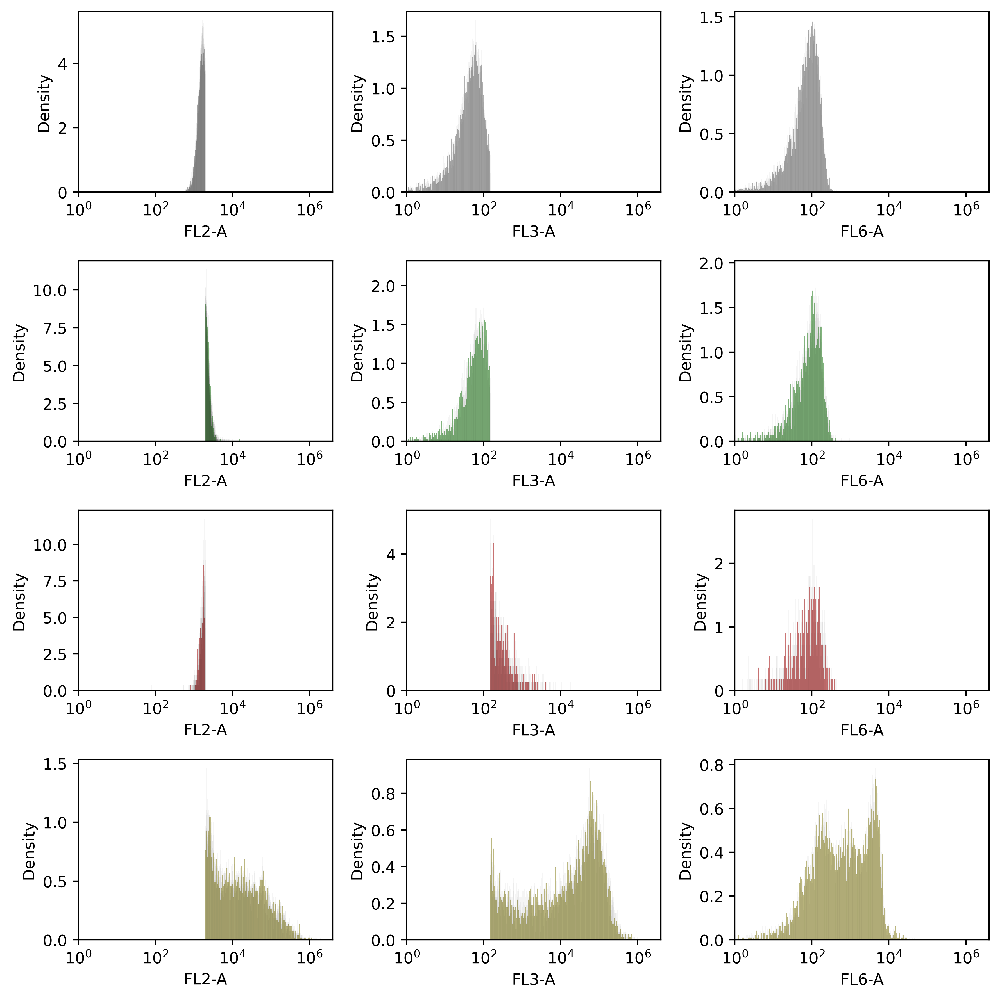

In [31]:
chan1 = "FL3-A"
chan2 = "FL2-A"
thresh1 = 150
thresh2 = 2000
alp = 0.5
kk=3
for data,name in zip(files,filenames):

    colos = ["grey", greens[kk],reds[kk],yellows[kk]]
    _,_ = quad(data,chan1,chan2,thresh1,thresh2,plot = True,title = name[:-20])
    

In [9]:
D9 = {filename[:-20]:file for filename,file in zip(filenames,files) if "D9" in filename}
D21 = {filename[:-20]:file for filename,file in zip(filenames,files) if "D21" in filename}

In [32]:
from collections import OrderedDict
chan1 = "FL3-A"
chan2 = "FL2-A"
thresh1 = 150
thresh2 = 2000
alp = 0.5
D9_sorted = OrderedDict(sorted(D9.items()))
D9_means = {}
D9_stds = {}
D9_cvs = {}

D9_k = {}
D9_s = {}
D9_p = {}

D9_k2 = {}
D9_s2 = {}
D9_p2 = {}

D9_k3 = {}
D9_s3 = {}
D9_p3 = {}
fracs ={}
bs_fracs ={}
for key,data in D9_sorted.items():
    print(key)
    quads,ratios = quad(data,chan1,chan2,thresh1,thresh2,plot =False,title = key)
    D9_means[key],D9_stds[key],D9_cvs[key] = get_stats(quads,ratios)
    D9_k[key],D9_s[key],D9_p[key] = get_corr(quads,ratios,"FL2-A","FL3-A")
    D9_k2[key],D9_s2[key],D9_p2[key] = get_corr(quads,ratios,"FL6-A","FL3-A")
    D9_k3[key],D9_s3[key],D9_p3[key] = get_corr(quads,ratios,"FL2-A","FL6-A")
    hula = bs_ratios(data,chan1,chan2,thresh1,thresh2,n_bs =1000,size_bs = 100)
    qs=[]
    for pp in [0,1,2,3]:
        qs.append([hula[kk][pp]*100 for kk in range(len(hula))])
    bs_fracs[key] =qs
    fracs[key] = ratios

D9+EU169
D9+EU169 +D17


In [20]:
colorb = [['#bd0404', '#bd0404', '#bd0404', '#bd0404'],
['#8102d6', '#8102d6', '#8102d6', '#8102d6'],
['#13ba04', '#13ba04', '#13ba04', '#13ba04'],
['#0b1347', '#0b1347', '#0b1347', '#0b1347'],
         ['#0e4d4a','#0e4d4a','#0e4d4a','#0e4d4a']]

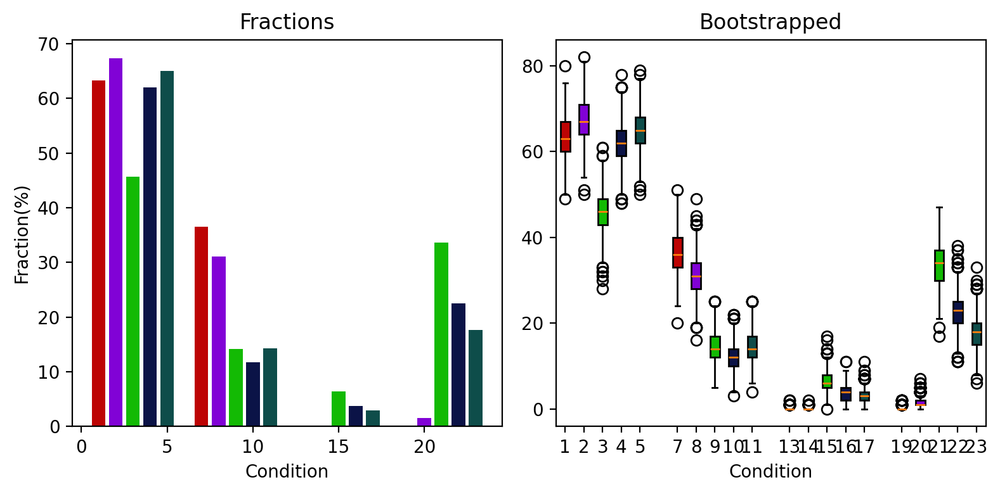

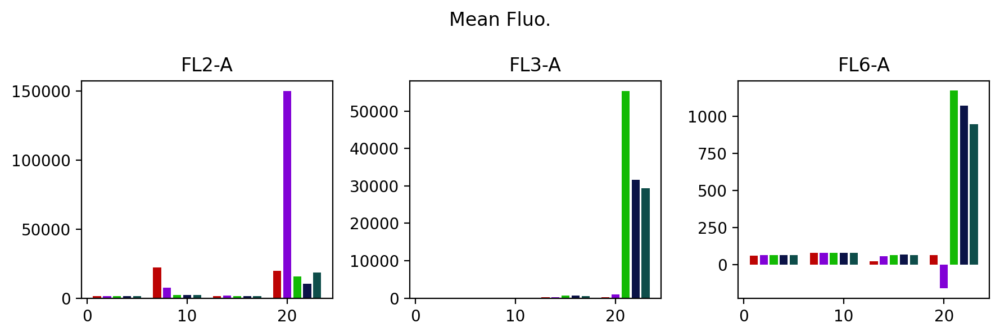

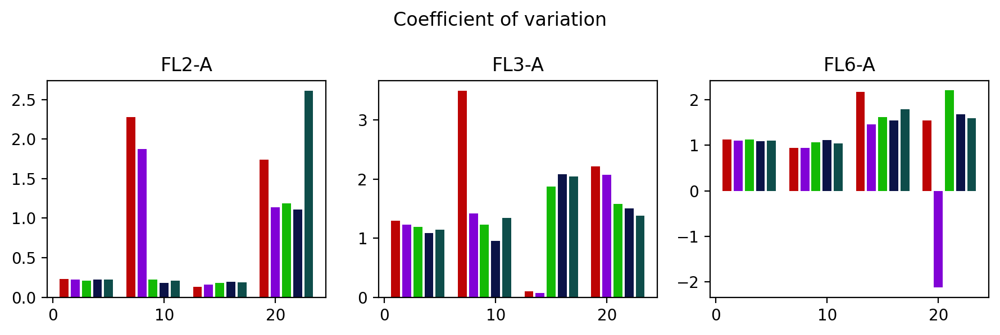

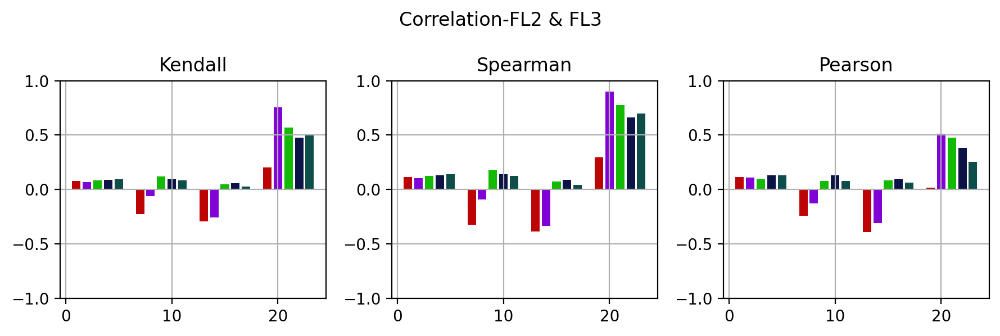

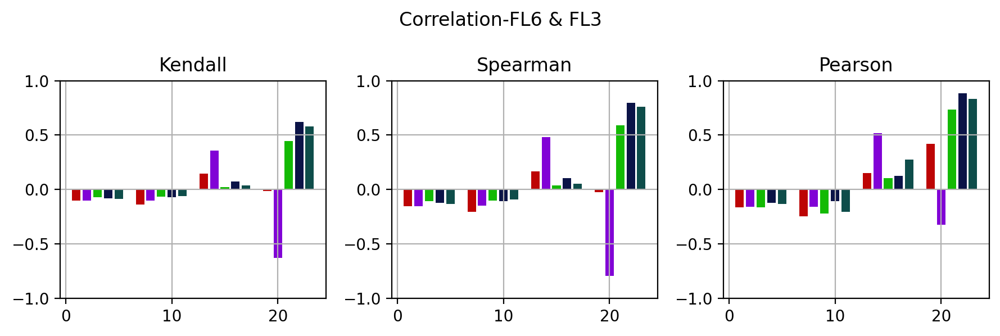

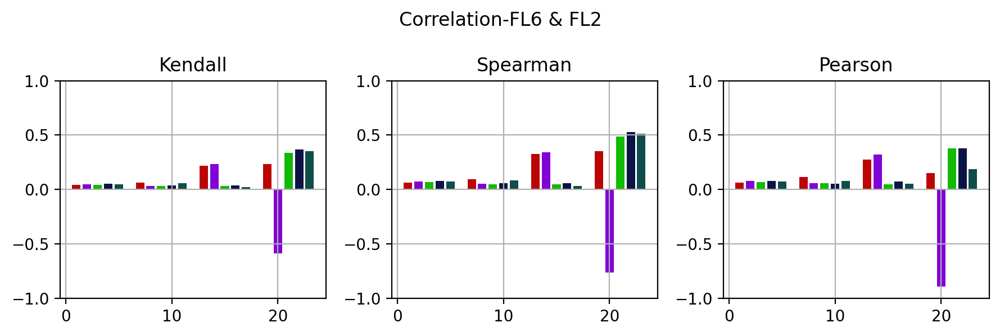

In [41]:
fig, axe = plt.subplots(1,2, figsize = (8,4), dpi = 200)
axe = axe.flatten()
coloree = [colorb[hh][0] for hh in [0,1,2,3,4]]

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
fps = ["FL2-A","FL3-A","FL6-A"]
hh = 0
spacing = [1,7,13,19]
for key,data in D9_means.items():
    bas = [ii+hh for ii in spacing]

    axe[0].bar(bas,np.array(fracs[key])*100,color = coloree[hh],label= key)
    # rectangular box plot
    colorb = [[coloree[hh]]*4]
    
    bplot1 = axe[1].boxplot(x=bs_fracs[key],
                     vert=True,  # vertical box alignment
                     patch_artist=True,  # fill with color
                     positions = bas)
    for patch, color in zip(bplot1['boxes'], colorb[0]):
        patch.set_facecolor(color)
    for ax,dat,chan in zip(axes,data,fps):
        ax.bar(bas,dat,color = coloree[hh],label= key)
        ax.set_title(chan)
        # ax.set_yscale("log")
    hh+=1
fig1.suptitle("Mean Fluo.")
handles, labels = ax.get_legend_handles_labels()
# fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
fig1.tight_layout()
axe[0].set_title("Fractions")
axe[1].set_title("Bootstrapped")

axe[0].set_xlabel("Condition")
axe[1].set_xlabel("Condition")
axe[0].set_ylabel("Fraction(%)")
fig.tight_layout()
fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
fps = ["FL2-A","FL3-A","FL6-A"]
hh = 0
spacing = [1,7,13,19]
for key,data in D9_cvs.items():
    for ax,dat,chan in zip(axes,data,fps):
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,dat,color = coloree[hh],label= key)
        ax.set_title(chan)
        # ax.set_yscale("log")
    hh+=1
fig1.suptitle("Coefficient of variation")
handles, labels = ax.get_legend_handles_labels()
# fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
fig1.tight_layout()
titss = ["Kendall","Spearman","Pearson"]
kkk = 0
fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k,D9_s,D9_p],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL2 & FL3")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()
kkk = 0

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k2,D9_s2,D9_p2],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL6 & FL3")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()
kkk = 0

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k3,D9_s3,D9_p3],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL6 & FL2")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()



In [376]:
hula = bs_ratios(files[2],chan1,chan2,thresh1,thresh2,n_bs =1000,size_bs = 300)
qs=[]
for pp in [0,1,2,3]:
    qs.append([hula[kk][pp] for kk in range(len(hula))])

D21
D21+D27
D21+EU169
D21+EU169 +D17
D21+EU169 +D30


IndexError: list index out of range

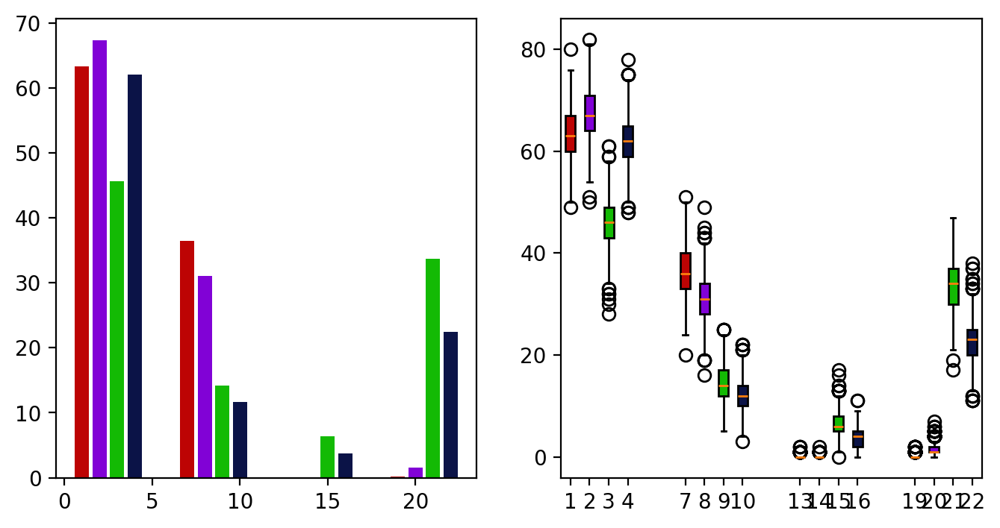

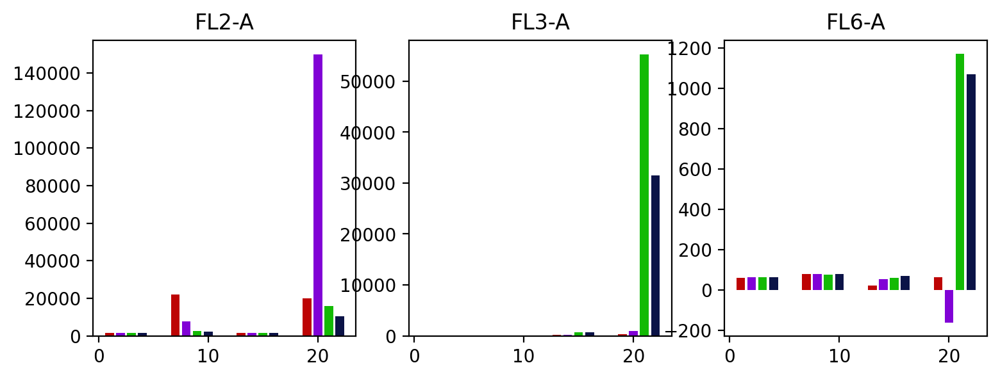

In [36]:
D9_means = {}
D9_stds = {}
D9_cvs = {}

D9_k = {}
D9_s = {}
D9_p = {}

D9_k2 = {}
D9_s2 = {}
D9_p2 = {}

D9_k3 = {}
D9_s3 = {}
D9_p3 = {}
fracs ={}
bs_fracs ={}
# Creates a sorted dictionary (sorted by key)
from collections import OrderedDict

D21_sorted = OrderedDict(sorted(D21.items()))

for key,data in D21_sorted.items():
    print(key)
    quads,ratios = quad(data,chan1,chan2,thresh1,thresh2,title = key)
    D9_means[key],D9_stds[key],D9_cvs[key] = get_stats(quads,ratios)
    D9_k[key],D9_s[key],D9_p[key] = get_corr(quads,ratios,"FL2-A","FL3-A")
    D9_k2[key],D9_s2[key],D9_p2[key] = get_corr(quads,ratios,"FL6-A","FL3-A")
    D9_k3[key],D9_s3[key],D9_p3[key] = get_corr(quads,ratios,"FL2-A","FL6-A")
    hula = bs_ratios(data,chan1,chan2,thresh1,thresh2,n_bs =1000,size_bs = 100)
    qs=[]
    for pp in [0,1,2,3]:
        qs.append([hula[kk][pp]*100 for kk in range(len(hula))])
    bs_fracs[key] =qs
    fracs[key] = ratios

fig, axe = plt.subplots(1,2, figsize = (8,4), dpi = 200)
axe = axe.flatten()

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
fps = ["FL2-A","FL3-A","FL6-A"]
hh = 0
spacing = [1,7,13,19]
for key,data in D9_means.items():
    bas = [ii+hh for ii in spacing]

    axe[0].bar(bas,np.array(fracs[key])*100,color = coloree[hh],label= key)
    # rectangular box plot
    colorb = [[coloree[hh]]*4]
    
    bplot1 = axe[1].boxplot(x=bs_fracs[key],
                     vert=True,  # vertical box alignment
                     patch_artist=True,  # fill with color
                     positions = bas)
    for patch, color in zip(bplot1['boxes'], colorb[0]):
        patch.set_facecolor(color)
    for ax,dat,chan in zip(axes,data,fps):
        ax.bar(bas,dat,color = coloree[hh],label= key)
        ax.set_title(chan)
        # ax.set_yscale("log")
    hh+=1
fig1.suptitle("Mean Fluo.")
handles, labels = ax.get_legend_handles_labels()
# fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
fig1.tight_layout()
axe[0].set_title("Fractions")
axe[1].set_title("Bootstrapped")

axe[0].set_xlabel("Condition")
axe[1].set_xlabel("Condition")
axe[0].set_ylabel("Fraction(%)")
fig.tight_layout()
fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
fps = ["FL2-A","FL3-A","FL6-A"]
hh = 0
spacing = [1,7,13,19]
for key,data in D9_cvs.items():
    for ax,dat,chan in zip(axes,data,fps):
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,dat,color = coloree[hh],label= key)
        ax.set_title(chan)
        # ax.set_yscale("log")
    hh+=1
fig1.suptitle("Coefficient of variation")
handles, labels = ax.get_legend_handles_labels()
# fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
fig1.tight_layout()
titss = ["Kendall","Spearman","Pearson"]
kkk = 0
fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k,D9_s,D9_p],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL2 & FL3")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()
kkk = 0

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k2,D9_s2,D9_p2],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL6 & FL3")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()
kkk = 0

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k3,D9_s3,D9_p3],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL6 & FL2")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()



[EU169]+ D21
[EU169]+ D21 +D39
[EU169]+ D21 +D39 +GZV
[EU169]+ D21 +D43


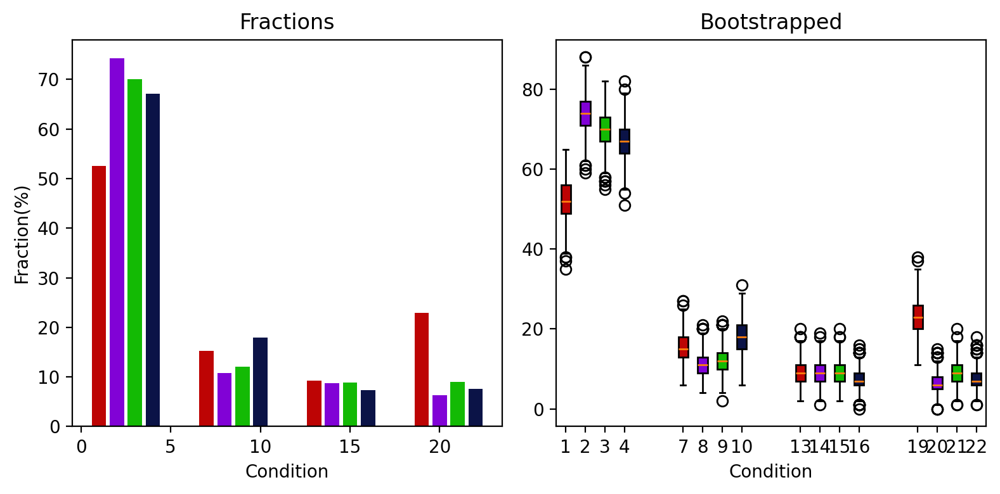

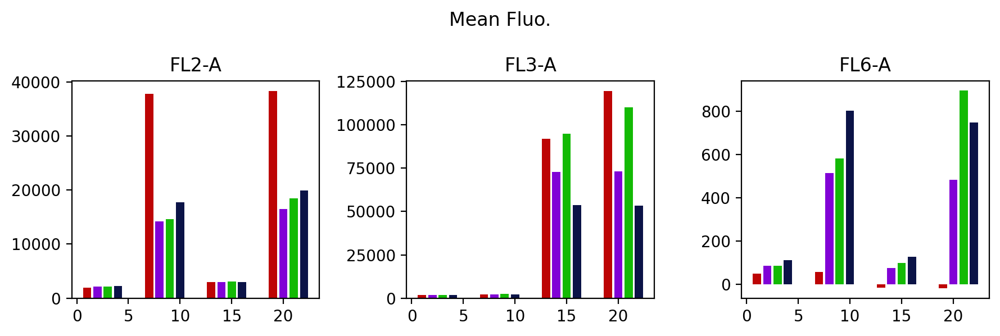

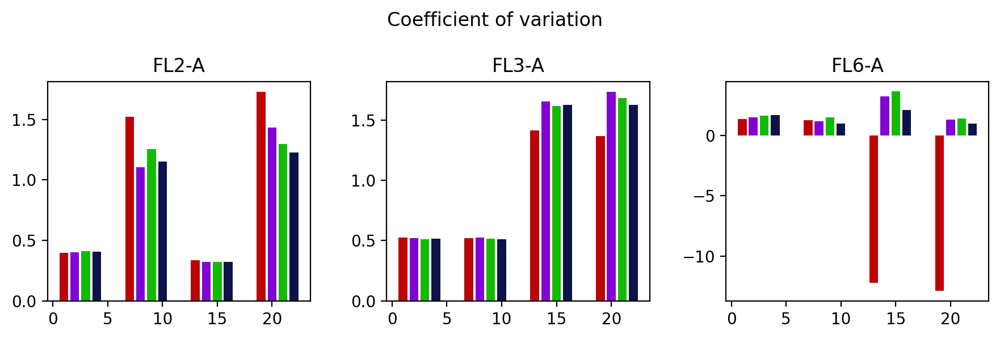

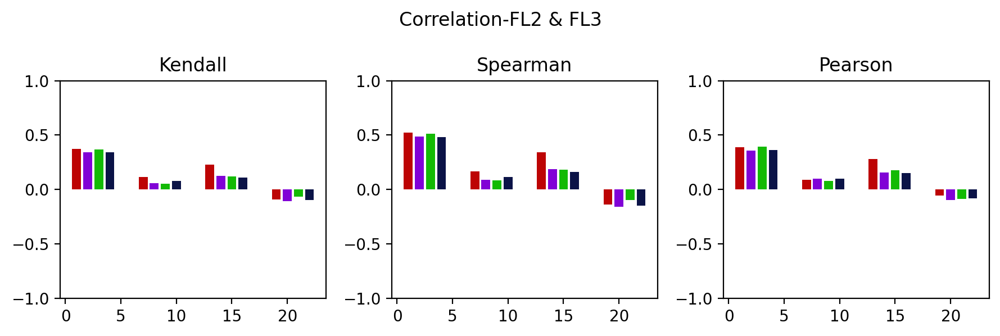

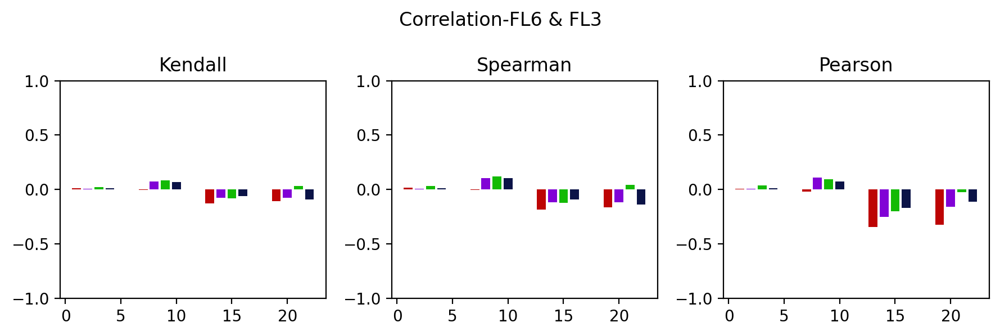

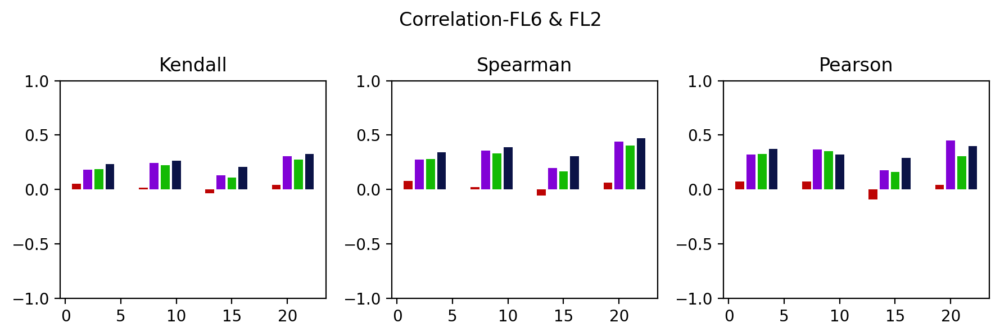

In [424]:
D9_means = {}
D9_stds = {}
D9_cvs = {}

D9_k = {}
D9_s = {}
D9_p = {}

D9_k2 = {}
D9_s2 = {}
D9_p2 = {}

D9_k3 = {}
D9_s3 = {}
D9_p3 = {}
fracs ={}
bs_fracs ={}
# Creates a sorted dictionary (sorted by key)
from collections import OrderedDict

D21_sorted = OrderedDict(sorted(D21.items()))

for key,data in D21_sorted.items():
    print(key)
    quads,ratios = quad(data,chan1,chan2,thresh1,thresh2,title = key)
    D9_means[key],D9_stds[key],D9_cvs[key] = get_stats(quads,ratios)
    D9_k[key],D9_s[key],D9_p[key] = get_corr(quads,ratios,"FL2-A","FL3-A")
    D9_k2[key],D9_s2[key],D9_p2[key] = get_corr(quads,ratios,"FL6-A","FL3-A")
    D9_k3[key],D9_s3[key],D9_p3[key] = get_corr(quads,ratios,"FL2-A","FL6-A")
    hula = bs_ratios(data,chan1,chan2,thresh1,thresh2,n_bs =1000,size_bs = 100)
    qs=[]
    for pp in [0,1,2,3]:
        qs.append([hula[kk][pp]*100 for kk in range(len(hula))])
    bs_fracs[key] =qs
    fracs[key] = ratios

fig, axe = plt.subplots(1,2, figsize = (8,4), dpi = 200)
axe = axe.flatten()

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
fps = ["FL2-A","FL3-A","FL6-A"]
hh = 0
spacing = [1,7,13,19]
for key,data in D9_means.items():
    bas = [ii+hh for ii in spacing]

    axe[0].bar(bas,np.array(fracs[key])*100,color = coloree[hh],label= key)
    # rectangular box plot
    colorb = [[coloree[hh]]*4]
    
    bplot1 = axe[1].boxplot(x=bs_fracs[key],
                     vert=True,  # vertical box alignment
                     patch_artist=True,  # fill with color
                     positions = bas)
    for patch, color in zip(bplot1['boxes'], colorb[0]):
        patch.set_facecolor(color)
    for ax,dat,chan in zip(axes,data,fps):
        ax.bar(bas,dat,color = coloree[hh],label= key)
        ax.set_title(chan)
        # ax.set_yscale("log")
    hh+=1
fig1.suptitle("Mean Fluo.")
handles, labels = ax.get_legend_handles_labels()
# fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
fig1.tight_layout()
axe[0].set_title("Fractions")
axe[1].set_title("Bootstrapped")

axe[0].set_xlabel("Condition")
axe[1].set_xlabel("Condition")
axe[0].set_ylabel("Fraction(%)")
fig.tight_layout()
fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
fps = ["FL2-A","FL3-A","FL6-A"]
hh = 0
spacing = [1,7,13,19]
for key,data in D9_cvs.items():
    for ax,dat,chan in zip(axes,data,fps):
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,dat,color = coloree[hh],label= key)
        ax.set_title(chan)
        # ax.set_yscale("log")
    hh+=1
fig1.suptitle("Coefficient of variation")
handles, labels = ax.get_legend_handles_labels()
# fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
fig1.tight_layout()
titss = ["Kendall","Spearman","Pearson"]
kkk = 0
fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k,D9_s,D9_p],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL2 & FL3")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()
kkk = 0

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k2,D9_s2,D9_p2],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL6 & FL3")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()
kkk = 0

fig1, axes = plt.subplots(1,3, figsize = (9,3), dpi = 200)
axes = axes.flatten()
for baba,ax in zip([D9_k3,D9_s3,D9_p3],axes):
    hh = 0
    spacing = [1,7,13,19]
    for key,data in baba.items():
        bas = [ii+hh for ii in spacing]
        ax.bar(bas,data[0],color = coloree[hh])
        ax.set_title(titss[kkk])
        ax.set_ylim(-1,1)
        ax.grid()
            # ax.set_yscale("log")
        hh+=1
    fig1.suptitle("Correlation-FL6 & FL2")
    kkk+=1
    handles, labels = ax.get_legend_handles_labels()
    # fig1.legend(handles, labels, loc='lower center',ncol=len(handles))
    fig1.tight_layout()



TypeError: Axis.set_ticks() missing 1 required positional argument: 'ticks'

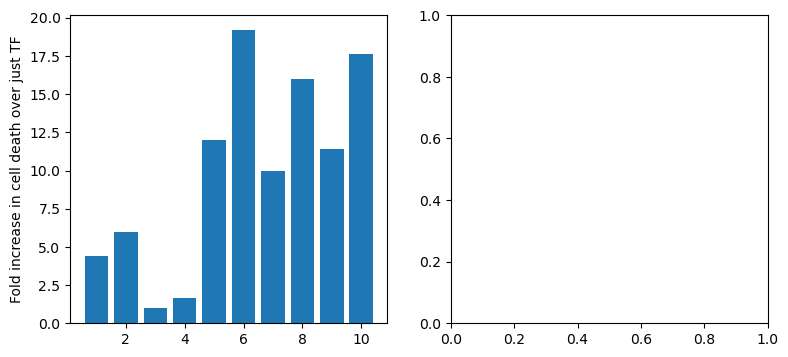

In [18]:
D9_means = {}
D9_stds = {}
D9_cvs = {}
fracs ={}
# for key,data in D9.items():
#     print(key)
#     quads,ratios = quad(data,chan1,chan2,thresh1,thresh2,title = key)
#     D9_means[key],D9_stds[key],D9_cvs[key] = get_stats(quads,ratios)
#     fracs[key] = ratios
labels = index
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(9, 4))
all_data1 =[6*10**6,5.7*10**6,2.2*10**6,5*10**6,9.6*10**6,5*10**5,8.2*10**5,3*10**6,8*10**6,8.8*10**6]
all_data1.sort()
all_data = all_data1/np.min(all_data1)
index = [3,4,1,2,7,9,5,8,10,6]
# rectangular box plot
ax1.bar(index1, all_data, color = blues[4])

ax1.bar(index2, all_data, color = blues[4])
ax1.set_ylabel("Fold increase in cell death over just TF")
# ax1.set_yscale('log')
# ax1.set_xticks()
index1 = [3,4,]

In [9]:
coloree = ['grey', greens[2],oranges[3],reds[3],purples[4],pinks[1]]

In [10]:
hfont = {'fontname':'Century Gothic'}

fgs= {'fontsize': 18}
fgss= {'fontsize': 16}

3430.1439507382643
330777.6861890731
285045.33811704593
329242.497673709
476482.2147567748
539964.5248188154


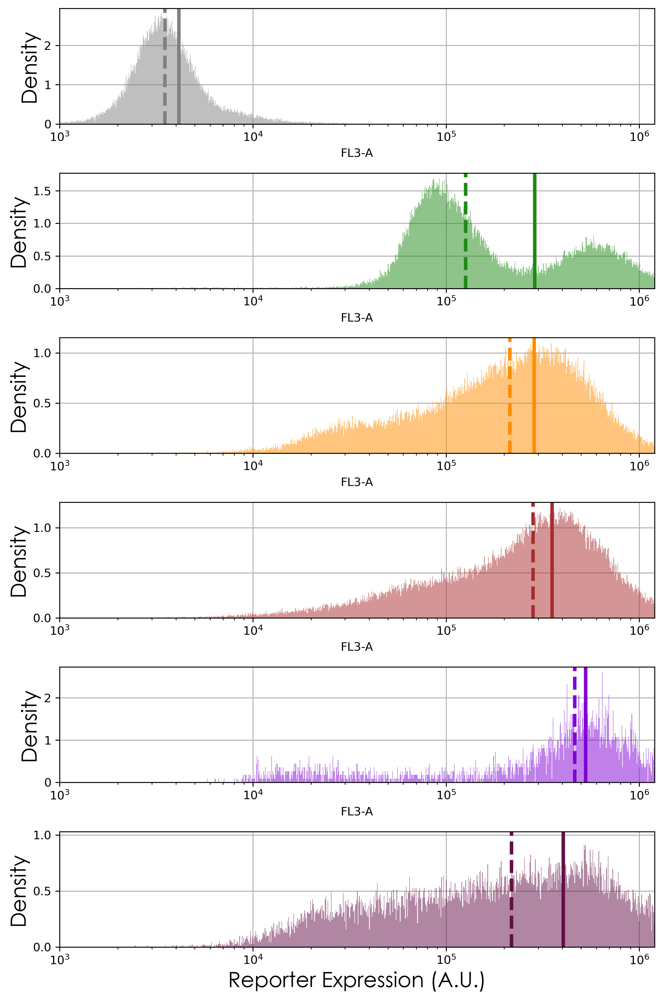

In [117]:
fig,axes = plt.subplots(6,1,figsize = (8,12),dpi = 300)
axes = axes.flatten()
fu =True
alp = 0.5
kk = 0
ytiks = [0,0.2,0.4,0.6,0.8,1,1.2,1.4]
xtiks = [10**-1,10**0,10**1,10**2,10**3,10**4,10**5,10**6]
means = []
medians = []
cvs=[]
# filess = [files[1], files[0],files[2],files[5],files[3],files[4]]
filess = [files[6], files[7],files[10],files[9],files[8],files[11]]

for ax, file in zip(axes,filess):
    colo = coloree[kk]
    if kk <2:
        
        dat = file[fps[2]]
    else:
        thresh = calculate_75th_percentile(file[fps[0]])

        dat = file.loc[file[fps[0]]>4000][fps[2]]
    sns.histplot(dat,ax = ax,color = colo,log_scale =True,stat = 'density', fill = fu, alpha = alp,bins =1000,edgecolor = "none")
    ax.axvline(x=dat.median(),lw=3,color = colo,ls = "--")
    ax.axvline(x=dat.mean(),lw=3,color = colo)    
    means.append(np.mean(dat))
    medians.append(np.median(dat))
    cvs.append(calculate_cv(dat))
    kk+=1
    ax.set_ylabel("Density",**hfont,**fgs)
    # ax.set_yticks(ytiks, ["" for i in ytiks],**hfont,**fgs)
    # ax.set_xticks(xtiks, ["" for i in xtiks],**hfont,**fgss)
    # ax.set_yticks(ytiks, [str(i) for i in ytiks],**hfont,**fgss)

    ax.set_xlim(10**3,1.2*10**6)
    # ax.set_ylim(0,0.8)
    ax.set_axisbelow(True)

    ax.grid(True)
    
    
ax.set_xlabel("Reporter Expression (A.U.)", **hfont,**fgs)


# axes[0].set_ylim(0,1.4)
# axes[2].set_ylim(0,1.4)

# ax.set_xticks(xtiks, [str(i) for i in xtiks],**hfont,**fgss)

fig.tight_layout()
# plt.savefig(r"C:\Users\cheta\OneDrive\Desktop\NJCCR GRANT\figures\2b.svg")


Text(0, 0.5, 'Reporter expression A.U.')

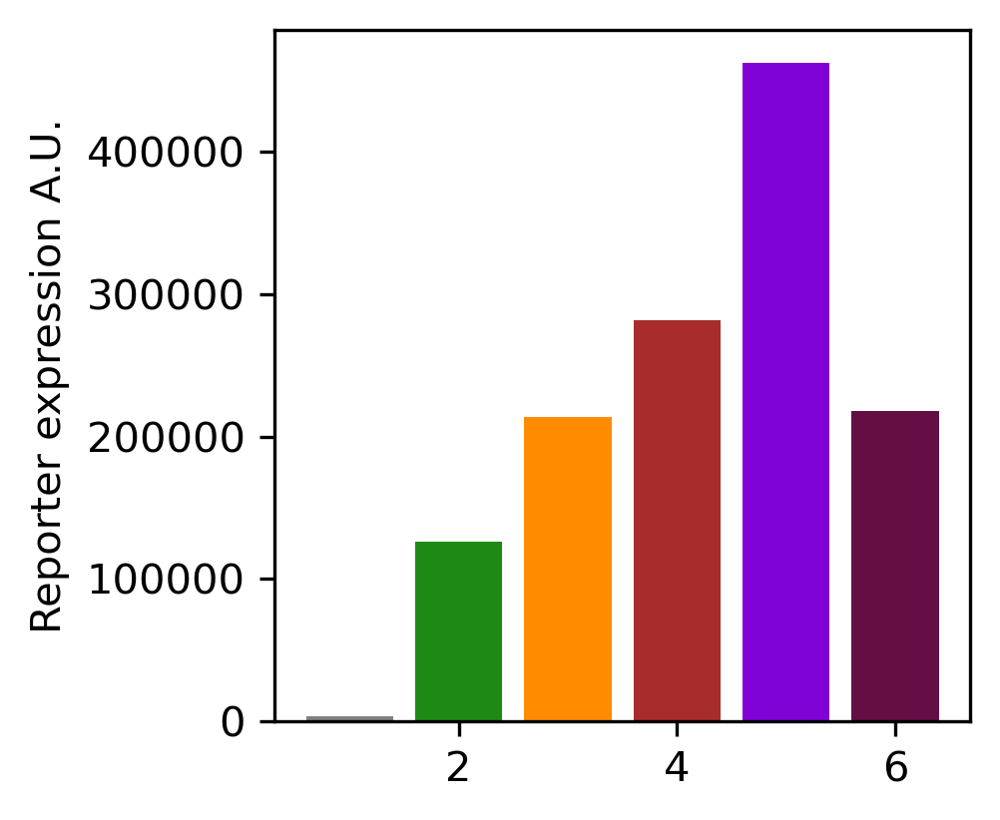

In [118]:
fig,ax = plt.subplots(1,1,figsize = (3,3),dpi = 300)
ax.bar([1,2,3,4,5,6],medians,color = coloree)
ax.set_ylabel("Reporter expression A.U.")
# ax.set_yscale("log")

12709.539440879807
13252.785404855938
9373.975659235028
11442.302447858961
11578.528625525343
16982.926757825735


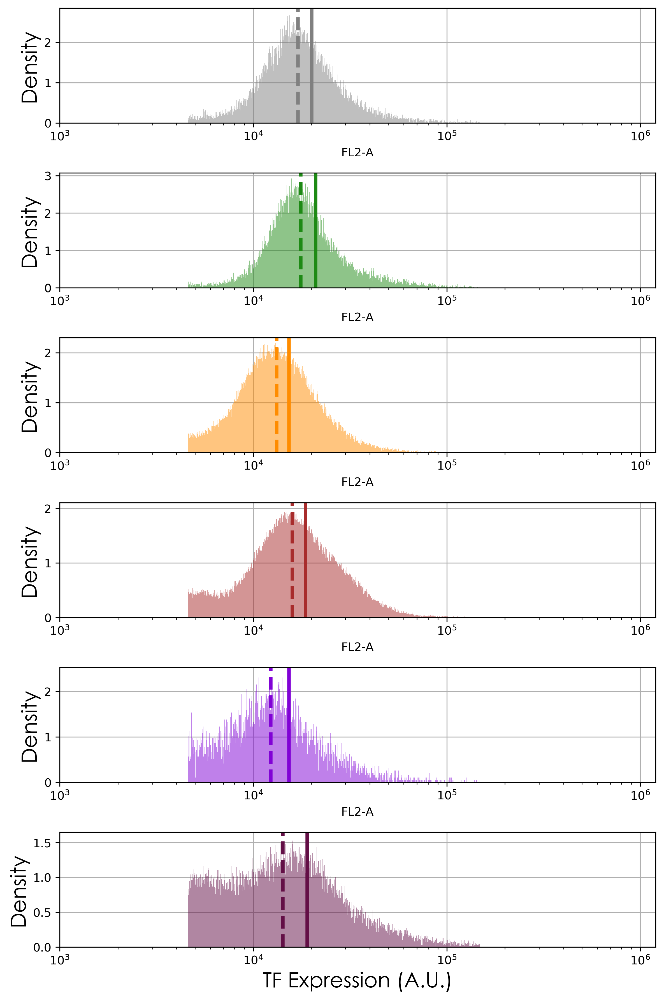

In [113]:
fig,axes = plt.subplots(6,1,figsize = (8,12),dpi = 300)
axes = axes.flatten()
fu =True
alp = 0.5
kk = 0
ytiks = [0,0.2,0.4,0.6,0.8,1,1.2,1.4]
xtiks = [10**-1,10**0,10**1,10**2,10**3,10**4,10**5,10**6]
means = []
medians = []
cvs=[]
# filess = [files[1], files[0],files[2],files[5],files[3],files[4]]
filess = [files[6], files[7],files[10],files[9],files[8],files[11]]

for ax, file in zip(axes,filess):
    colo = coloree[kk]
    if kk <2:
        
        dat = file[fps[1]]
    else:
        thresh = calculate_75th_percentile(file[fps[0]])

        dat = file.loc[file[fps[0]]>2000][fps[1]]
    sns.histplot(dat,ax = ax,color = colo,log_scale =True,stat = 'density', fill = fu, alpha = alp,bins =1000,edgecolor = "none")
    ax.axvline(x=dat.median(),lw=3,color = colo,ls = "--")
    ax.axvline(x=dat.mean(),lw=3,color = colo)    
    means.append(np.mean(dat))
    medians.append(np.median(dat))
    cvs.append(calculate_cv(dat))
    kk+=1
    ax.set_ylabel("Density",**hfont,**fgs)
    # ax.set_yticks(ytiks, ["" for i in ytiks],**hfont,**fgs)
    # ax.set_xticks(xtiks, ["" for i in xtiks],**hfont,**fgss)
    # ax.set_yticks(ytiks, [str(i) for i in ytiks],**hfont,**fgss)

    ax.set_xlim(10**3,1.2*10**6)
    # ax.set_ylim(0,0.8)
    ax.set_axisbelow(True)

    ax.grid(True)
    
    
ax.set_xlabel("TF Expression (A.U.)", **hfont,**fgs)


# axes[0].set_ylim(0,1.4)
# axes[2].set_ylim(0,1.4)

# ax.set_xticks(xtiks, [str(i) for i in xtiks],**hfont,**fgss)

fig.tight_layout()
# plt.savefig(r"C:\Users\cheta\OneDrive\Desktop\NJCCR GRANT\figures\2b.svg")


Text(0, 0.5, 'TF expression A.U.')

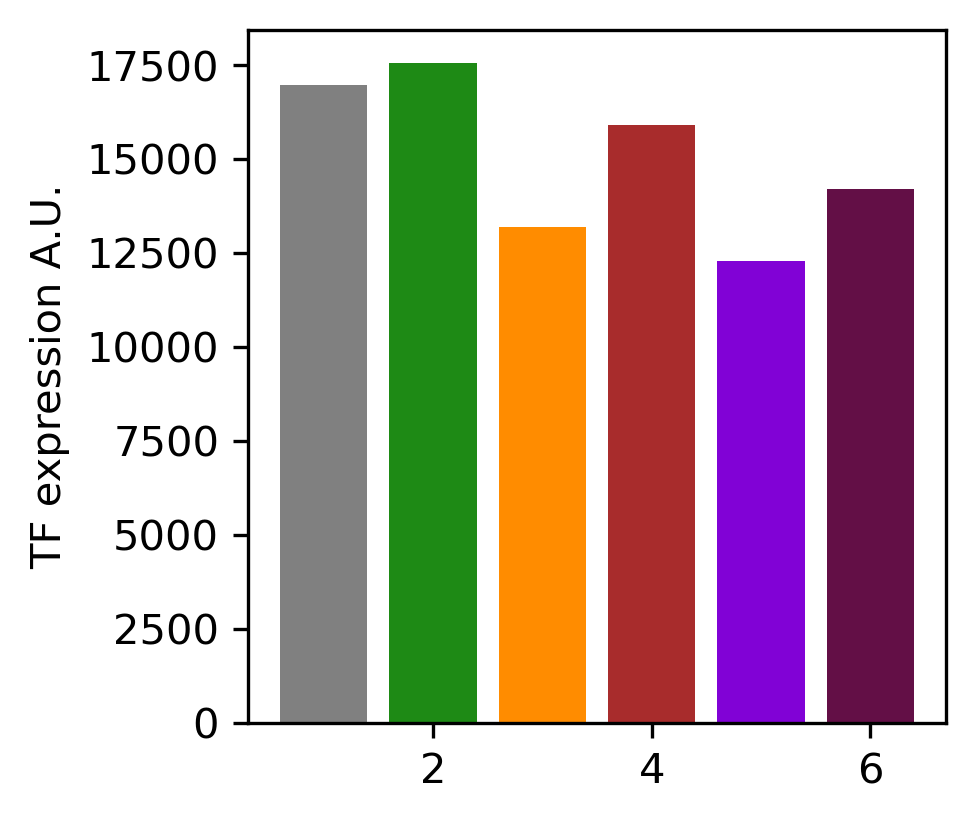

In [114]:
fig,ax = plt.subplots(1,1,figsize = (3,3),dpi = 300)
ax.bar([1,2,3,4,5,6],medians,color = coloree)
ax.set_ylabel("TF expression A.U.")

645.2055624025622
768.4513522689003
7178.9171263252365
10618.516687419737
1884.6435266353653
4573.390516550877


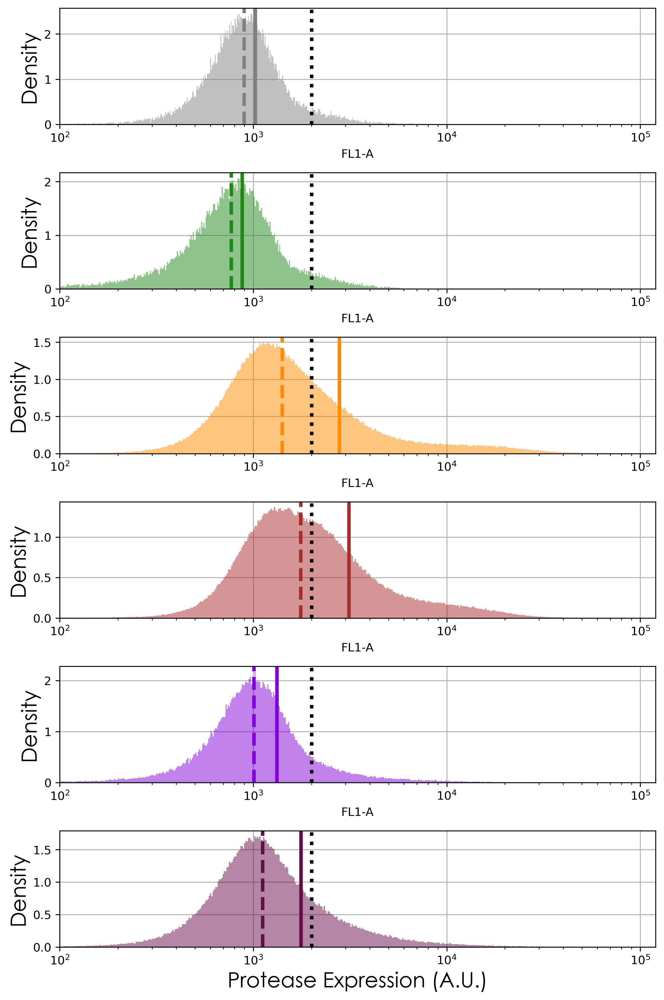

In [115]:
fig,axes = plt.subplots(6,1,figsize = (8,12),dpi = 300)
axes = axes.flatten()
fu =True
alp = 0.5
kk = 0
ytiks = [0,0.2,0.4,0.6,0.8,1,1.2,1.4]
xtiks = [10**-1,10**0,10**1,10**2,10**3,10**4,10**5,10**6]
means = []
medians = []
cvs=[]
# filess = [files[1], files[0],files[2],files[3],files[4],files[5]]
filess = [files[6], files[7],files[10],files[9],files[8],files[11]]

channel = fps[0]
for ax, file in zip(axes,filess):
    colo = coloree[kk]
    if kk <2:
        
        dat = file[channel]
        thresh = calculate_75th_percentile(dat)
    else:
        dat = file.loc[file[fps[0]]>0][channel]
        thresh = calculate_75th_percentile(dat)

    sns.histplot(dat,ax = ax,color = colo,log_scale =True,stat = 'density', fill = fu, alpha = alp,bins =1000,edgecolor = "none")
    ax.axvline(x=dat.median(),lw=3,color = colo,ls = "--")
    ax.axvline(x=dat.mean(),lw=3,color = colo)    
    ax.axvline(x = 2000,lw = 3,color = "k",ls = ":")
    means.append(np.mean(dat))
    medians.append(np.median(dat))
    cvs.append(calculate_cv(dat))
    kk+=1
    ax.set_ylabel("Density",**hfont,**fgs)
    # ax.set_yticks(ytiks, ["" for i in ytiks],**hfont,**fgs)
    # ax.set_xticks(xtiks, ["" for i in xtiks],**hfont,**fgss)
    # ax.set_yticks(ytiks, [str(i) for i in ytiks],**hfont,**fgss)

    ax.set_xlim(10**2,1.2*10**5)
    # ax.set_ylim(0,0.8)
    ax.set_axisbelow(True)

    ax.grid(True)
    
    
ax.set_xlabel("Protease Expression (A.U.)", **hfont,**fgs)


# axes[0].set_ylim(0,1.4)
# axes[2].set_ylim(0,1.4)

# ax.set_xticks(xtiks, [str(i) for i in xtiks],**hfont,**fgss)

fig.tight_layout()
# plt.savefig(r"C:\Users\cheta\OneDrive\Desktop\NJCCR GRANT\figures\2b.svg")


Text(0, 0.5, 'Protease expression A.U.')

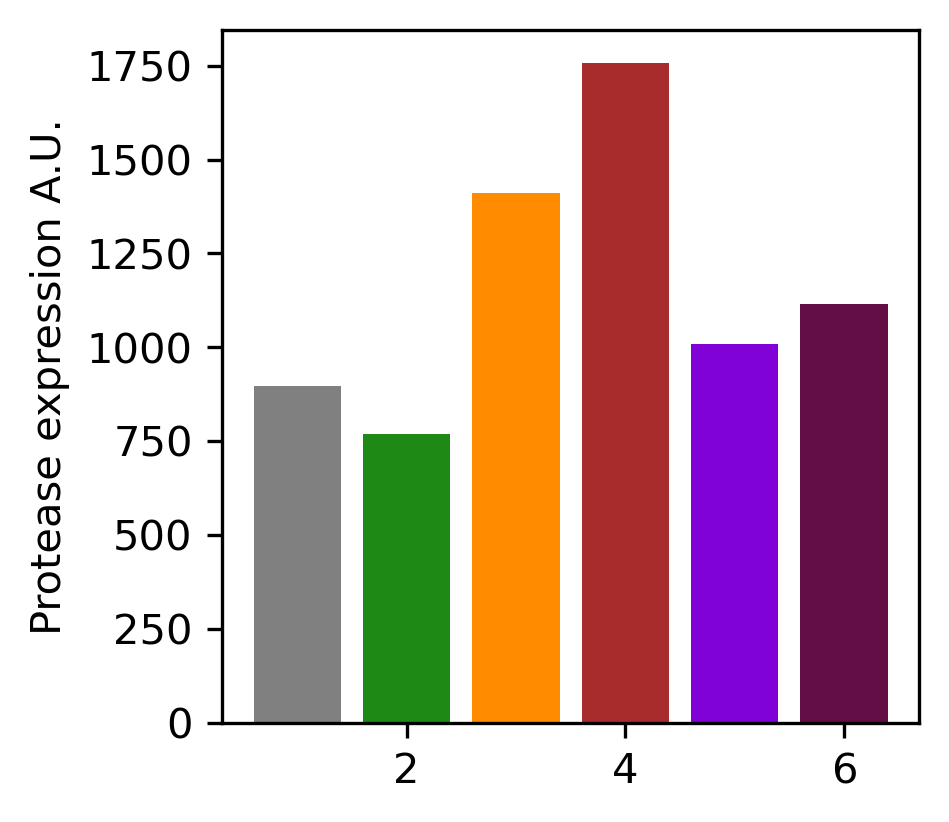

In [116]:
fig,ax = plt.subplots(1,1,figsize = (3,3),dpi = 300)
ax.bar([1,2,3,4,5,6],medians,color = coloree)
ax.set_ylabel("Protease expression A.U.")

In [70]:
for mm,mn in zip(means,medians):
    # print(mm)
    print(mn)
    # print(mm/means[0])
    print(mn/medians[0])

29.412736236572265
1.0
1645.888565917969
55.95836282213842
17.55240869140607
0.5967621832334363
93789.9156015625
3188.7517994651116
74.1741771850586
2.521838722805709


In [47]:
labs = [f"10\u00b{i}" for i in [-1,0,1,2,3,4,5,6]]

SyntaxError: (unicode error) 'unicodeescape' codec can't decode bytes in position 2-6: truncated \uXXXX escape (818539499.py, line 1)

In [48]:
i=4

In [43]:
import numpy as np

def calculate_cv(data):
    """Calculate the coefficient of variation of a dataset"""
    mean = np.mean(data)
    std_dev = np.std(data)
    print(std_dev)
    cv = (std_dev / mean) 
    return cv,std_dev

In [71]:
import numpy as np

def calculate_75th_percentile(data):
    """Calculate the 75th percentile of a dataset"""
    percentile_75 = np.percentile(data, 75)
    return percentile_75